进行CV的图像分割和彩色照片提取

对于一部分图片采用OTSU可以分割得到想要的玻璃，但是是否直接输入也可以得到不错的结果？
分割之后会不会使得原本的爆裂信息消失了 —— 部分会的，然后直接输入的话得到结果一般（有误）

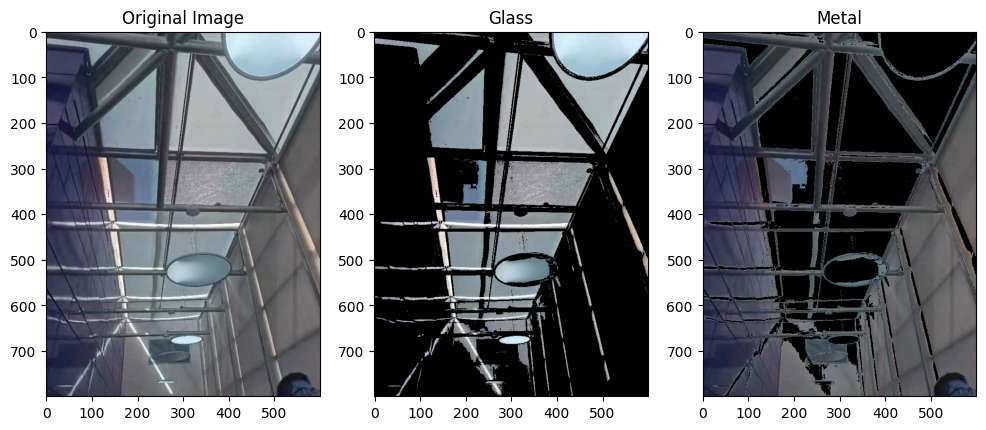

True

In [14]:
import cv2
from matplotlib import pyplot as plt

# cv2.imread()用于读取图片文件
image = cv2.imread('D:/glassData/inputData/curtain1.jpg')

# cv2.COLOR_BGR2GRAY 将BGR格式转换成灰度图片
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# otsu图像分割为前景和背景
ret1, th1 = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU)

# 提取前景部分
foreground = cv2.bitwise_and(image, image, mask=th1)

# 提取背景部分
background = cv2.bitwise_and(image, image, mask=cv2.bitwise_not(th1))

# 显示原始图像、前景和背景
plt.figure(figsize=(12, 6))
plt.subplot(131), plt.imshow(image, cmap='gray'), plt.title('Original Image')
plt.subplot(132), plt.imshow(foreground, cmap='gray'), plt.title('Glass')
plt.subplot(133), plt.imshow(background, cmap='gray'), plt.title('Metal')

# 显示图像
plt.show()
cv2.imwrite('D:/glassData/outputData/r1.jpg',foreground)


In [15]:
import torch
from torchvision.models import resnet18
from torchvision import transforms
import torch.nn as nn
import os
import glob
from PIL import Image

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
test_dir = r"D:/Files/SoftWare_5/软件工程/组队项目/Test_Data/"
img_size = 224
class_names = ["class_0", "class_1"]

model = resnet18()
# model = nn.Sequential(*list(model.children())[:-1],  # [b, 512, 1, 1] -> 接全连接层 
#                           # torch.nn.Flatten(),
#                           nn.Linear(512, 2)).to(device)   # 添加全连接层
channel_in = model.fc.in_features
model.fc = nn.Sequential(nn.Linear(channel_in,2))

model.to(device)
model.load_state_dict(torch.load("./resnet18-2Class.pth"))
model.eval()
with torch.no_grad():
    tf = transforms.Compose([
                lambda x: Image.open(x).convert('RGB'),
                transforms.Resize((img_size, img_size)),
                # transforms.CenterCrop(self.resize),
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
            ])
    img_paths = glob.glob(os.path.join(test_dir, "*.jpg"))
    #img_paths = test_dir
    for image_path in img_paths:
        img = tf(image_path).unsqueeze(0)
        pred = model(img.to(device))
        cls_id = pred.argmax(dim=1).item()
        print("img: ", image_path, "\npred: ", pred, "\ncls: ", cls_id)
        print("\n")

img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\curtain1.jpg 
pred:  tensor([[ 1.5006, -1.3630]], device='cuda:0') 
cls:  0


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\curtain2.jpg 
pred:  tensor([[ 2.8557, -3.3106]], device='cuda:0') 
cls:  0


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\n1.jpg 
pred:  tensor([[-12.0156,  11.7444]], device='cuda:0') 
cls:  1


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\n2.jpg 
pred:  tensor([[-16.8875,  16.4262]], device='cuda:0') 
cls:  1


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\n3.jpg 
pred:  tensor([[-3.0922,  3.1843]], device='cuda:0') 
cls:  1


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\n4.jpg 
pred:  tensor([[-9.9000,  9.7668]], device='cuda:0') 
cls:  1


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\n5.jpg 
pred:  tensor([[-7.3452,  7.2276]], device='cuda:0') 
cls:  1


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test_Data\n6.jpg 
pred:  tensor([[-5.9447,  5.9649]], device='cuda:0') 
cls:  1


img:  D:/Files/SoftWare_5/软件工程/组队项目/Test

<font color = blue>这里分割出来发现预测正确，但是未分割的话预测错误</font>

In [58]:
#构建整个流程尝试
import cv2
from matplotlib import pyplot as plt
import torch
from torchvision.models import resnet18
from torchvision import transforms
import torch.nn as nn
import os
import glob
from PIL import Image

def Classify(filename):
     #--------------------进行幕墙分割---------------------#
    # cv2.imread()用于读取图片文件
    filename = os.path.normpath(filename)
    image = cv2.imread(filename)

    # cv2.COLOR_BGR2GRAY 将BGR格式转换成灰度图片
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # otsu图像分割为前景和背景
    ret1, th1 = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU)
    
    # 提取前景部分 - glass graph
    glassphoto = cv2.bitwise_and(image, image, mask=th1)
    #添加绘制，可删除后期
    plt.imshow(glassphoto, cmap='gray'), plt.title('Glass')
    plt.show()
    #--------------------进行幕墙检测---------------------#
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    img_size = 224
    class_names = ["class_0", "class_1"]
    model = resnet18()
    channel_in = model.fc.in_features
    
    model.fc = nn.Sequential(nn.Linear(channel_in,2))
    model.to(device)
    model.load_state_dict(torch.load("./resnet18-2Class.pth"))
    model.eval()
    
    with torch.no_grad():
        tf = transforms.Compose([
                    lambda x: x.convert('RGB'),
                    transforms.Resize((img_size, img_size)),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                         std=[0.229, 0.224, 0.225])
                ])
        #将openCV的照片格式转化成为PIL中IMAGE的照片形式
        image_rgb = cv2.cvtColor(glassphoto, cv2.COLOR_BGR2RGB)
        image_pil = Image.fromarray(image_rgb)
        img = tf(image_pil).unsqueeze(0)
        pred = model(img.to(device))
        cls_id = pred.argmax(dim=1).item()
        print("pred: ", pred, "\ncls: ", cls_id)
        if(cls_id == 0):
            print("完整玻璃\n")
            return True
        else:
             print("碎玻璃\n")
             return False

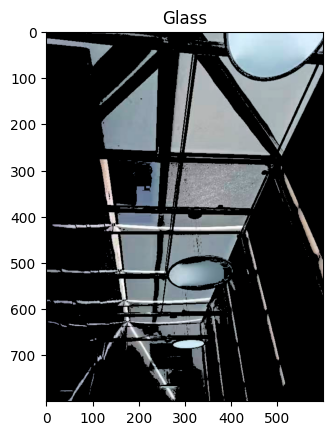

pred:  tensor([[-0.2822,  0.4478]], device='cuda:0') 
cls:  1
碎玻璃



False

In [59]:
Classify('D:/glassData/inputData/curtain1.jpg')

进行大数据批量测试：自制数据测试

D:\glassData\inputData\image\0.jpg


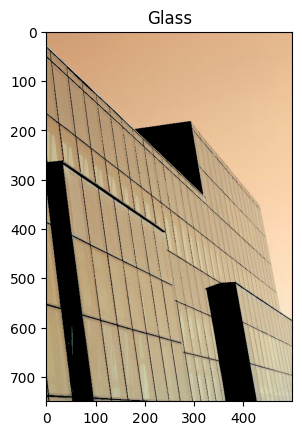

pred:  tensor([[ 2.4304, -2.5606]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\1.jpg


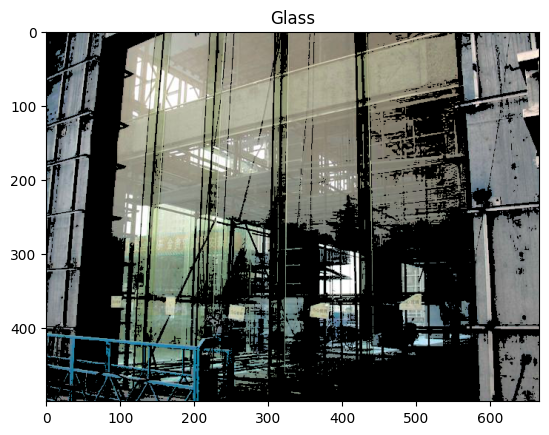

pred:  tensor([[ 1.1664, -0.9993]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\10.jpg


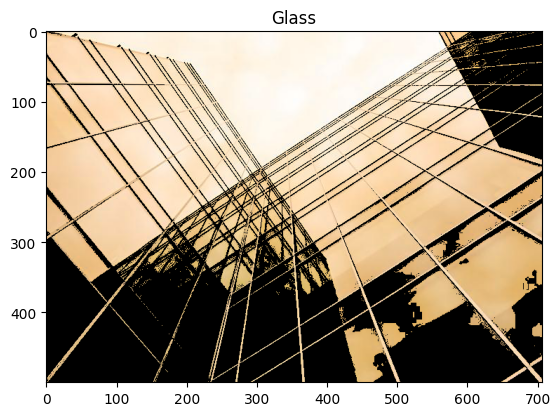

pred:  tensor([[-1.0573,  1.2669]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\11.jpg


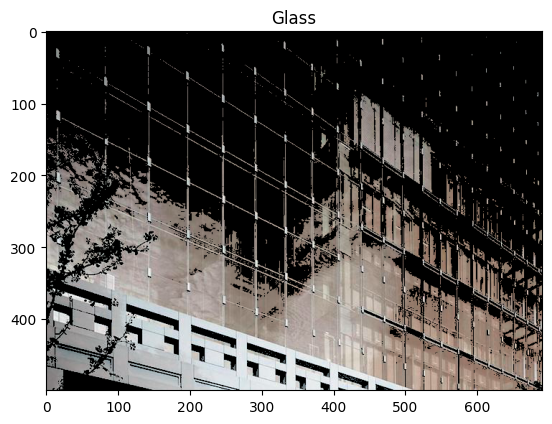

pred:  tensor([[-2.4109,  2.5976]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\12.jpg


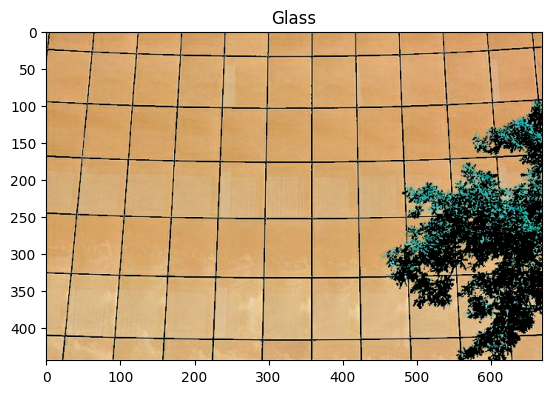

pred:  tensor([[ 2.5111, -3.0944]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\13.jpg


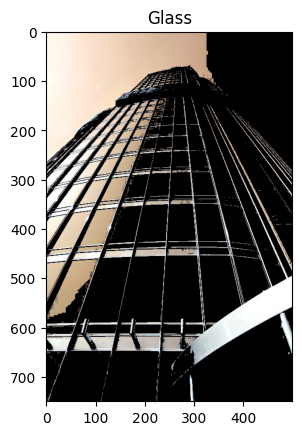

pred:  tensor([[0.1241, 0.0621]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\14.jpg


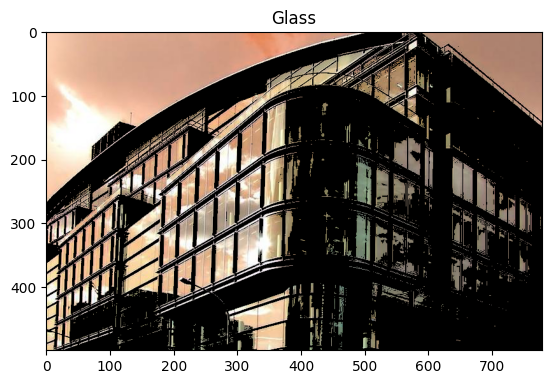

pred:  tensor([[0.1271, 0.0780]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\15.jpg


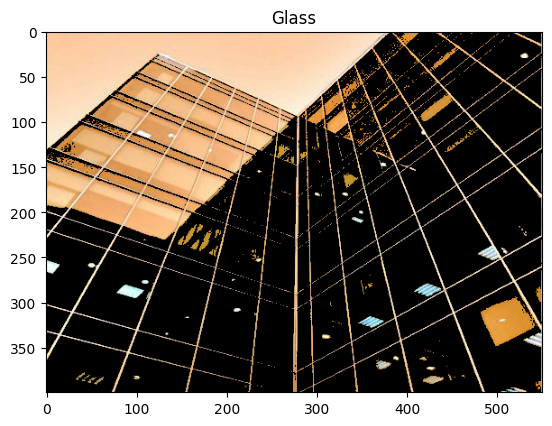

pred:  tensor([[ 1.1125, -1.0209]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\16.jpg


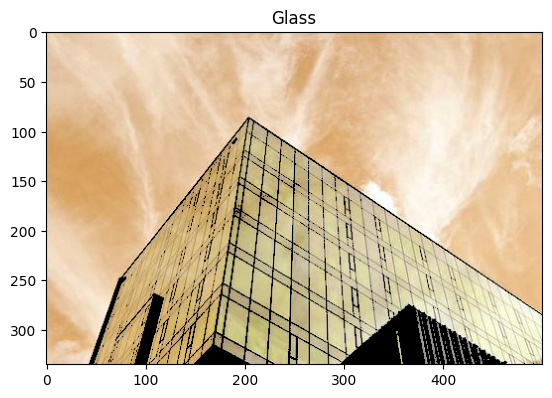

pred:  tensor([[ 1.0760, -0.9513]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\17.jpg


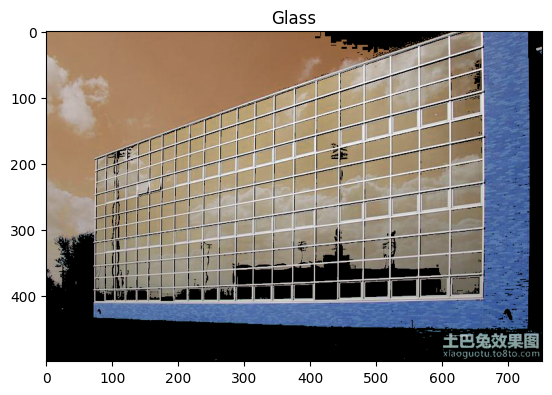

pred:  tensor([[ 4.0559, -5.6525]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\18.jpg


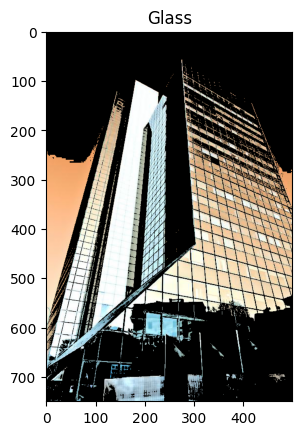

pred:  tensor([[0.0048, 0.1228]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\19.jpg


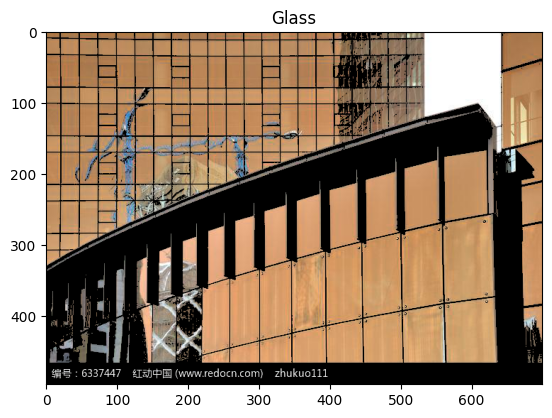

pred:  tensor([[ 2.7178, -3.2805]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\2.jpg


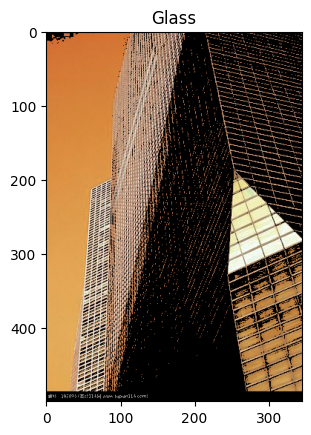

pred:  tensor([[ 0.2685, -0.1137]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\20.jpg


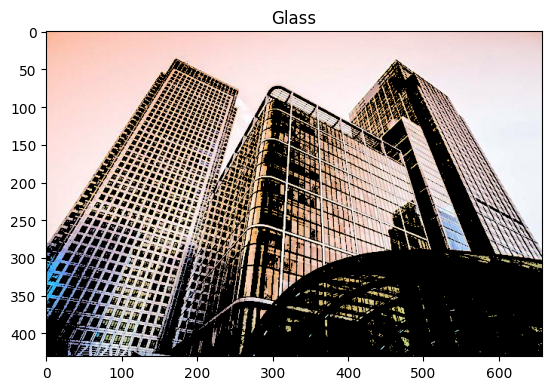

pred:  tensor([[-1.2731,  1.5036]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\21.jpg


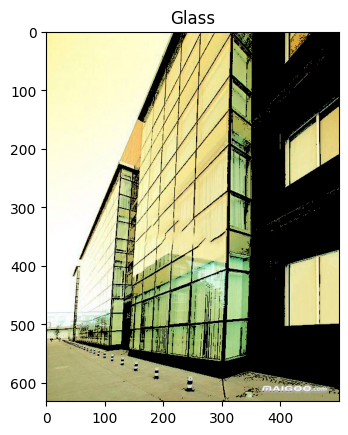

pred:  tensor([[ 1.0571, -0.9266]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\22.jpg


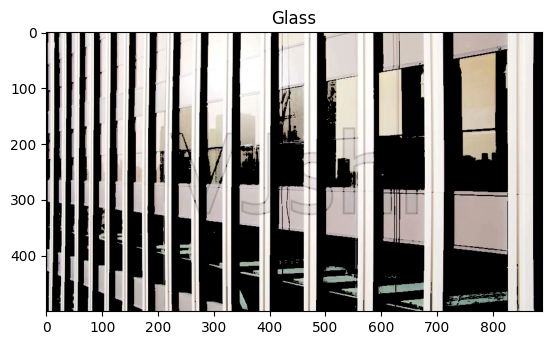

pred:  tensor([[ 2.9229, -3.5914]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\23.jpg


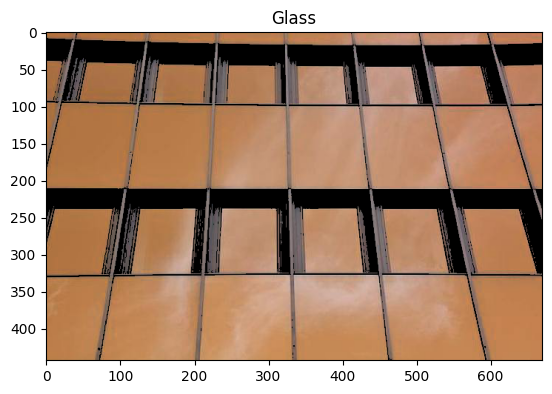

pred:  tensor([[ 3.1312, -3.9118]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\24.jpg


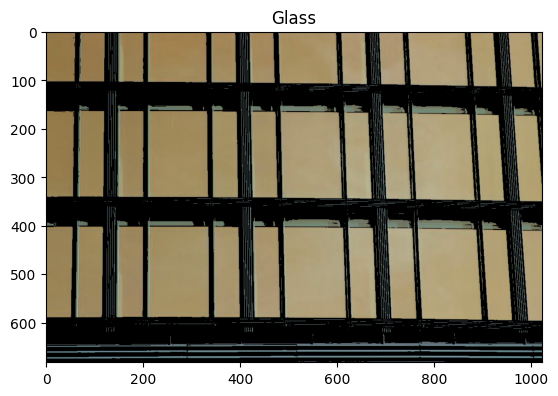

pred:  tensor([[ 2.9871, -3.7197]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\25.jpg


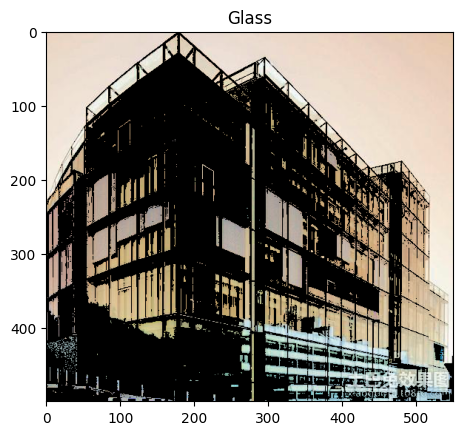

pred:  tensor([[ 1.3944, -1.2664]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\26.jpg


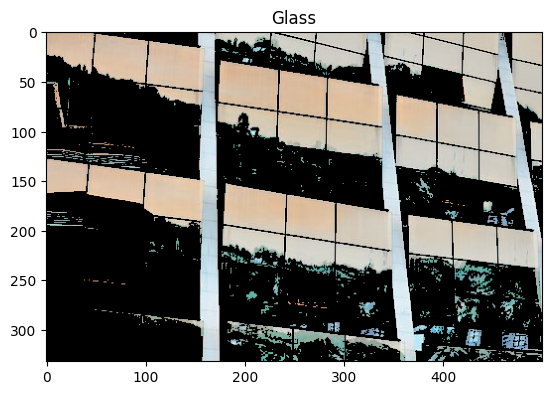

pred:  tensor([[ 1.7407, -1.7091]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\27.jpg


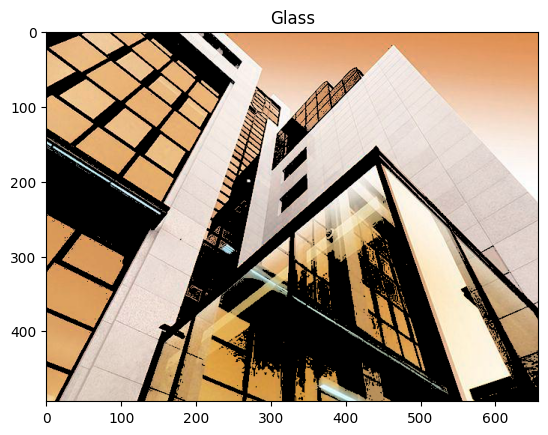

pred:  tensor([[-3.9520,  4.0598]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\28.jpg


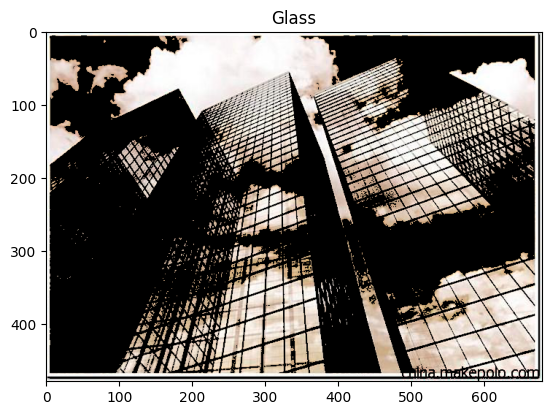

pred:  tensor([[-4.9813,  5.0624]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\3.jpg


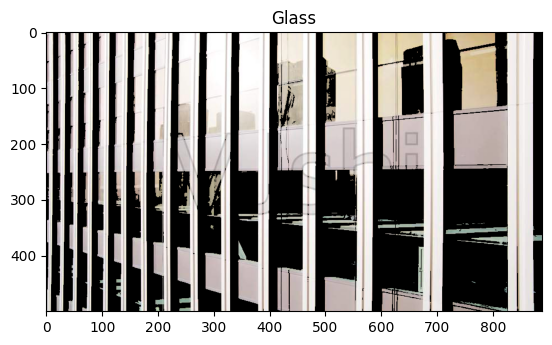

pred:  tensor([[ 2.6128, -2.9113]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\30.jpg


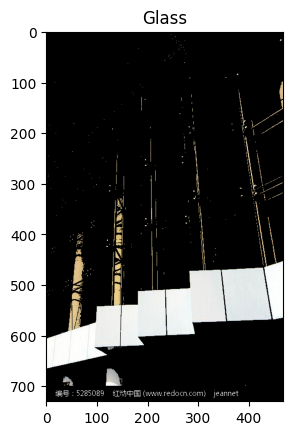

pred:  tensor([[-0.9918,  1.1256]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\31.jpg


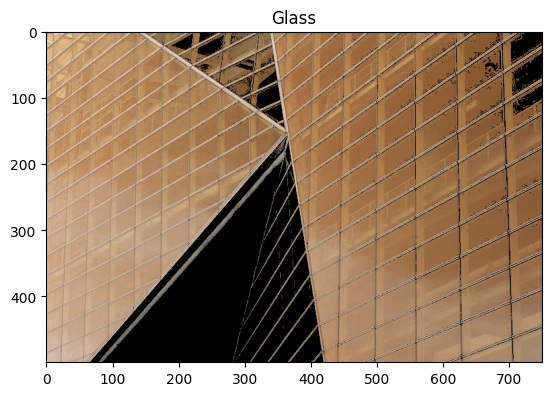

pred:  tensor([[ 0.7816, -0.7346]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\32.jpg


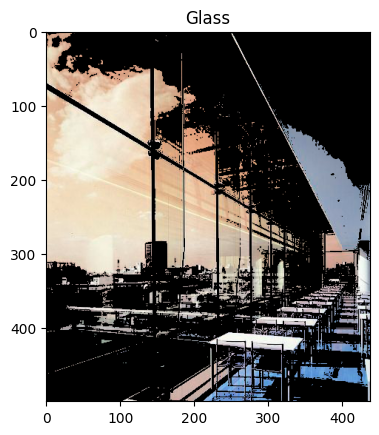

pred:  tensor([[-1.0616,  1.2185]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\33.jpg


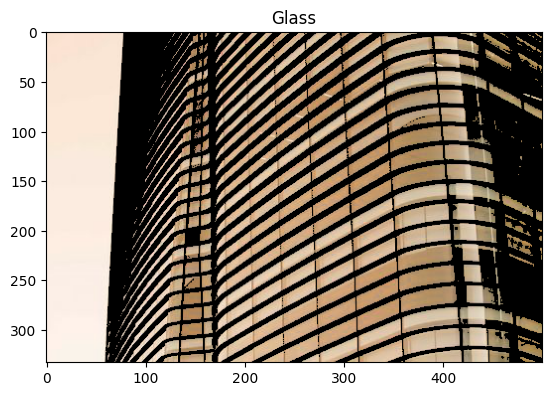

pred:  tensor([[ 1.8464, -1.7838]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\34.jpg


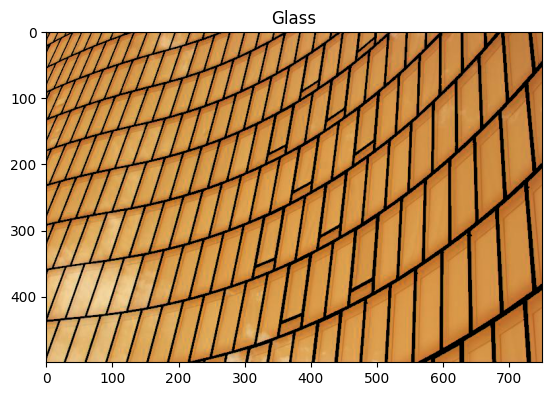

pred:  tensor([[ 2.8910, -3.6392]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\35.jpg


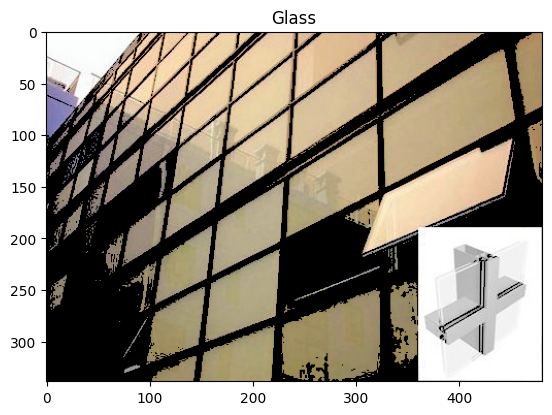

pred:  tensor([[ 2.4076, -2.6331]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\36.jpg


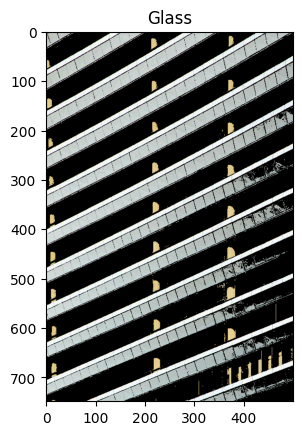

pred:  tensor([[ 1.5369, -1.4521]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\37.jpg


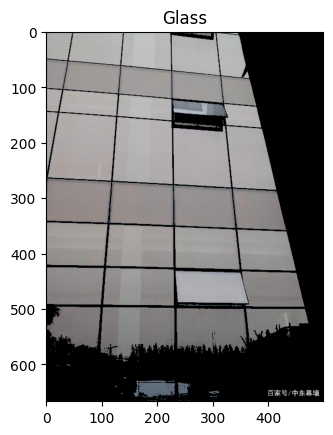

pred:  tensor([[ 2.0713, -2.3516]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\38.jpg


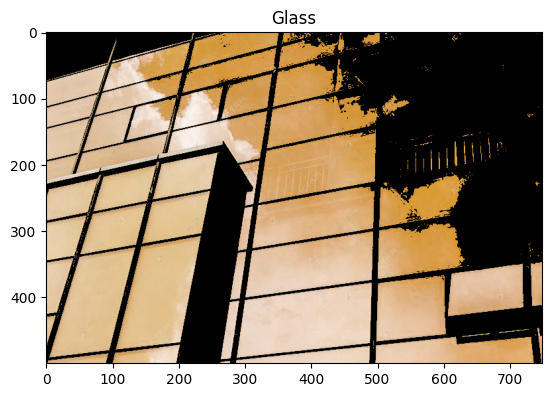

pred:  tensor([[0.0314, 0.1136]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\39.jpg


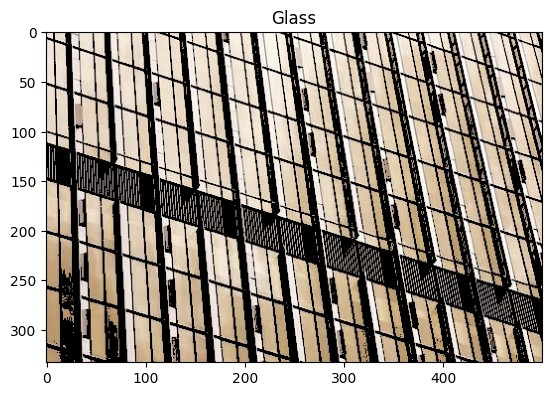

pred:  tensor([[ 1.1011, -0.9425]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\4.jpg


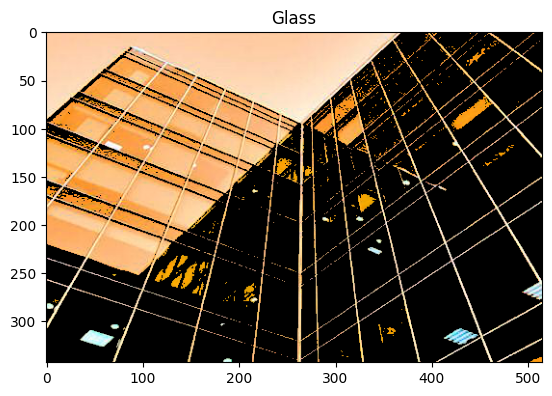

pred:  tensor([[ 1.0700, -1.0307]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\40.jpg


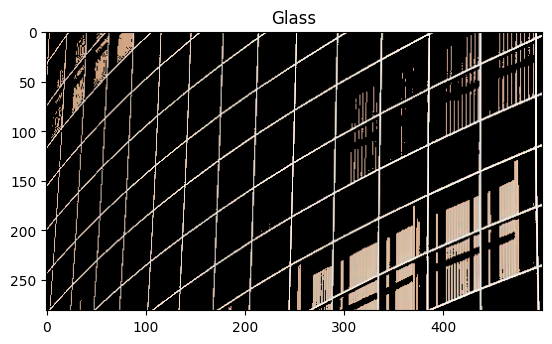

pred:  tensor([[ 1.6279, -1.5537]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\41.jpg


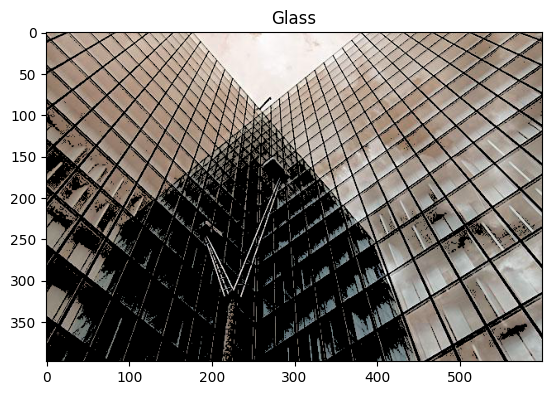

pred:  tensor([[-1.7636,  1.9459]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\42.jpg


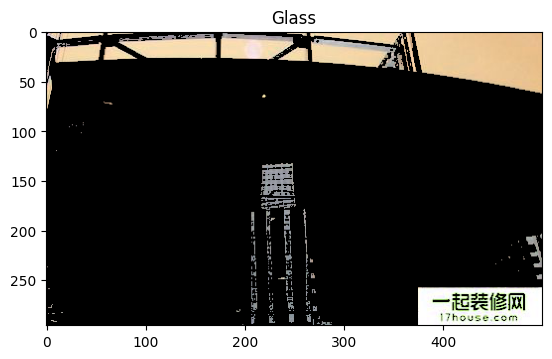

pred:  tensor([[0.0275, 0.1266]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\43.jpg


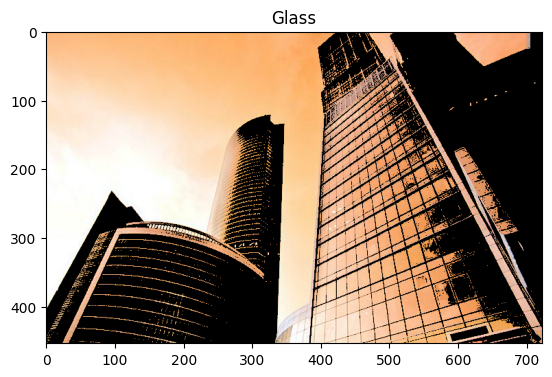

pred:  tensor([[ 0.6985, -0.8338]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\44.jpg


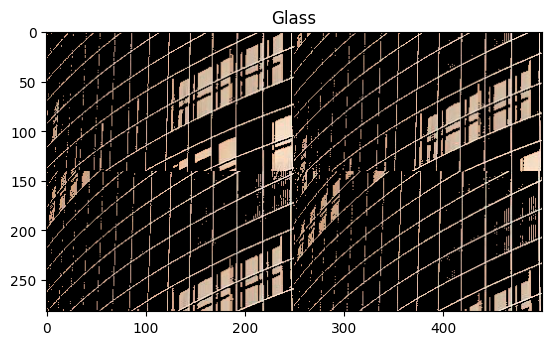

pred:  tensor([[-2.4580,  2.6176]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\45.jpg


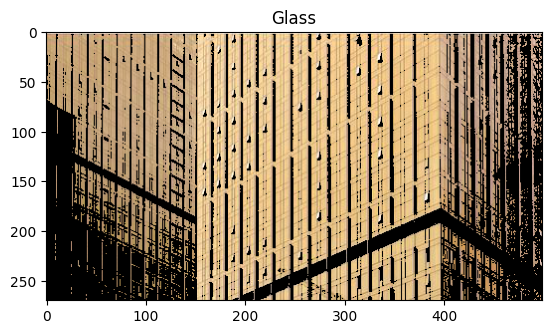

pred:  tensor([[ 2.5919, -3.1481]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\46.jpg


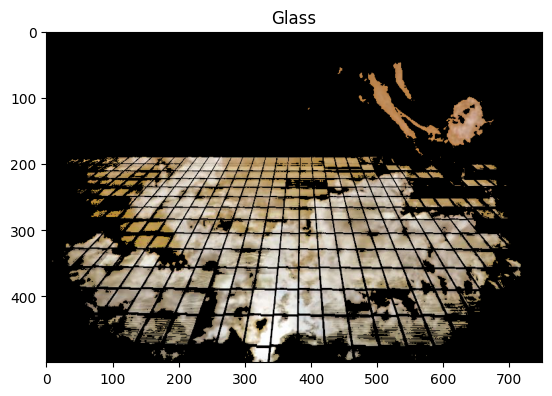

pred:  tensor([[-1.3029,  1.4176]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\47.jpg


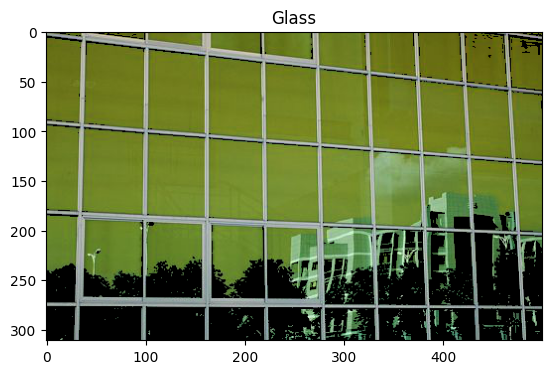

pred:  tensor([[ 3.6740, -4.9263]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\48.jpg


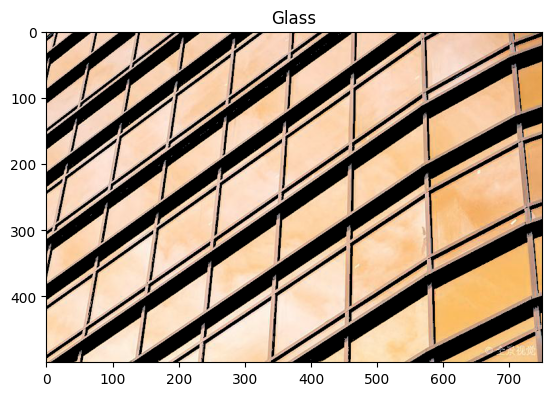

pred:  tensor([[ 2.6836, -3.0191]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\49.jpg


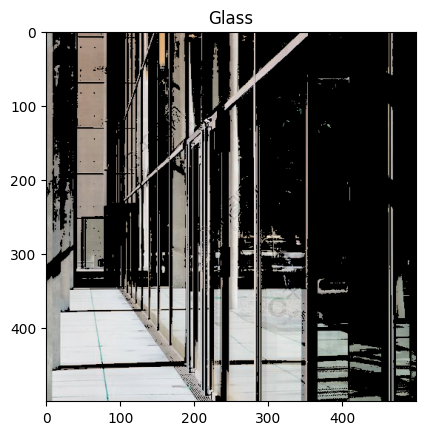

pred:  tensor([[ 1.5269, -1.6526]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\5.jpg


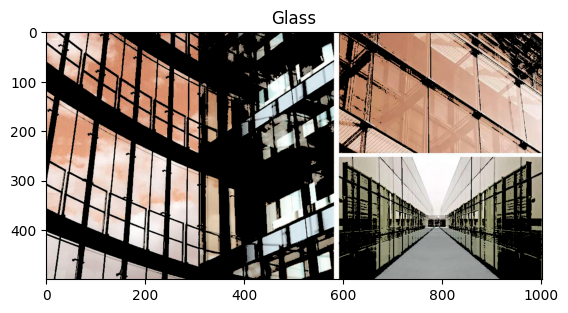

pred:  tensor([[-2.9850,  3.1328]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\50.jpg


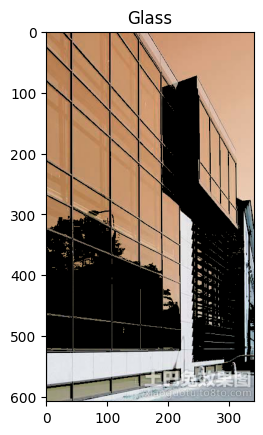

pred:  tensor([[ 3.5619, -4.5614]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\51.jpg


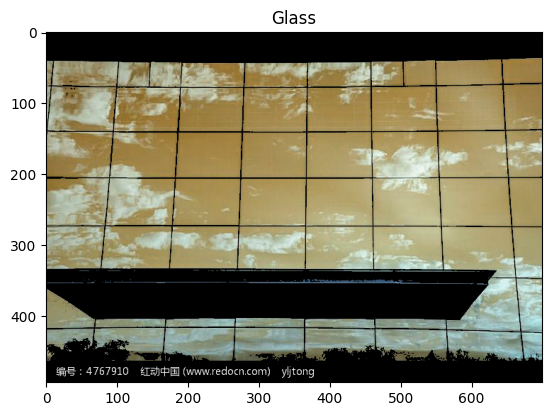

pred:  tensor([[ 2.4298, -2.8962]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\52.jpg


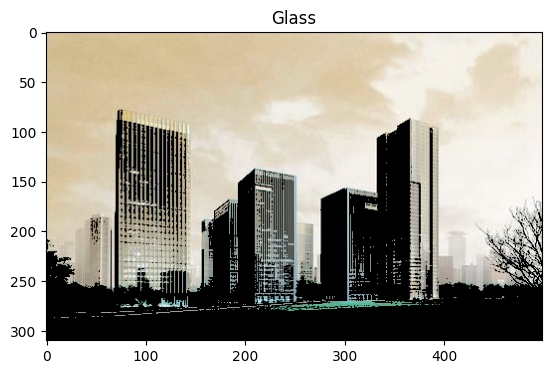

pred:  tensor([[ 2.3988, -2.4925]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\53.jpg


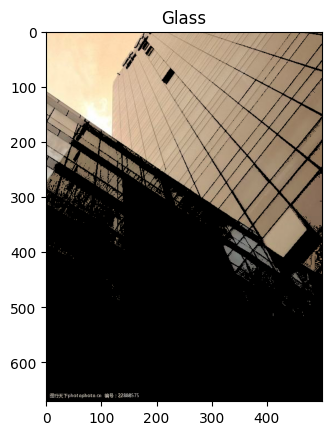

pred:  tensor([[ 1.2887, -1.1442]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\54.jpg


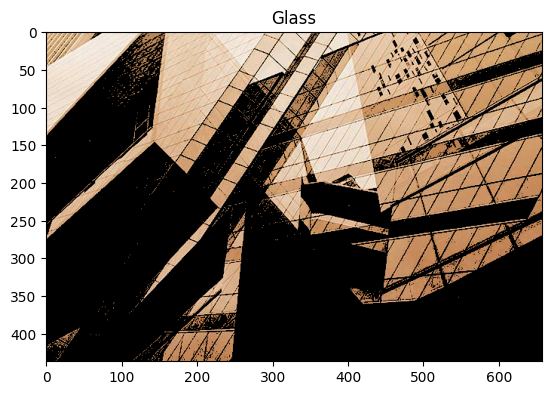

pred:  tensor([[-2.8178,  2.9439]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\55.jpg


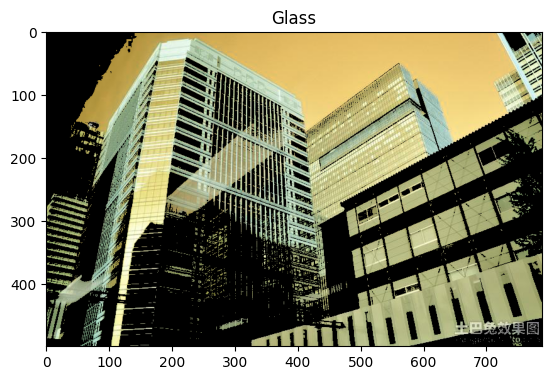

pred:  tensor([[ 1.1013, -0.9395]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\56.jpg


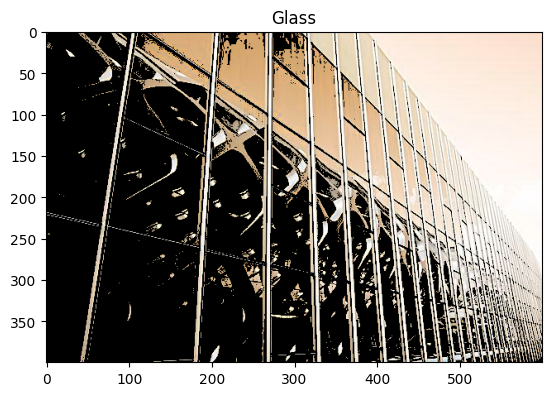

pred:  tensor([[-4.1734,  4.2688]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\57.jpg


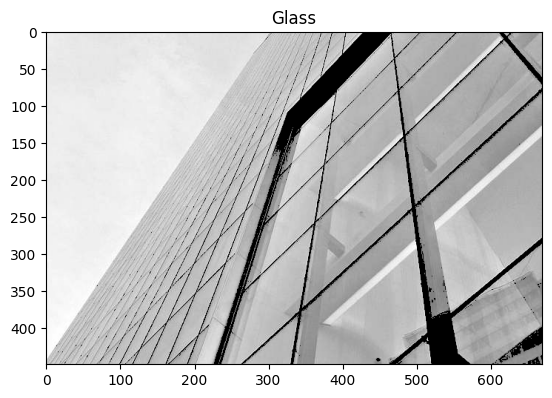

pred:  tensor([[ 2.2130, -2.2121]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\58.jpg


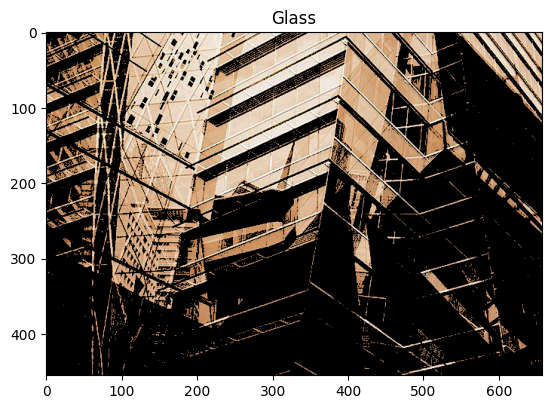

pred:  tensor([[-5.7528,  5.8197]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\6.jpg


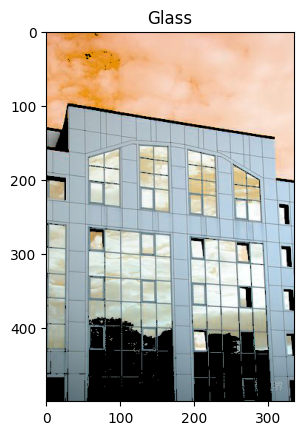

pred:  tensor([[ 4.5459, -6.1832]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\60.jpg


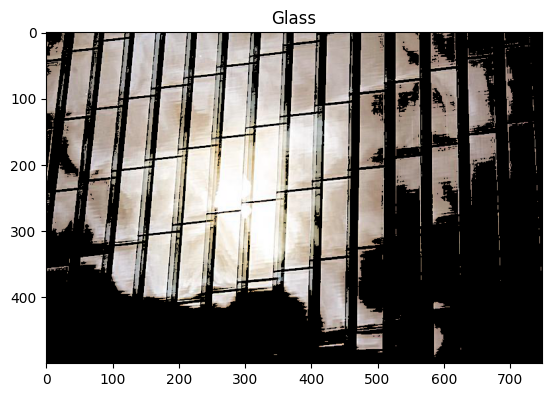

pred:  tensor([[ 1.8664, -1.8792]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\61.jpg


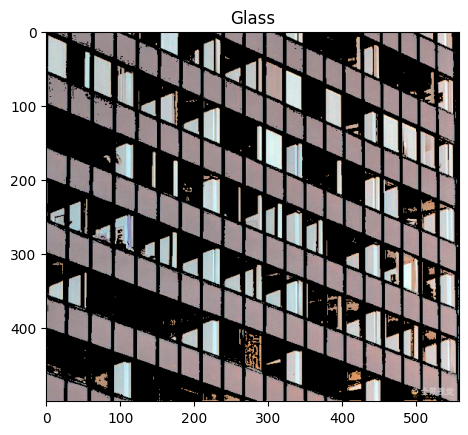

pred:  tensor([[ 3.4039, -4.4796]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\62.jpg


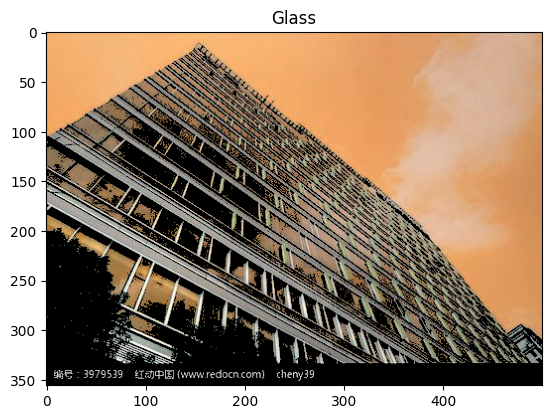

pred:  tensor([[ 0.8950, -0.8680]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\63.jpg


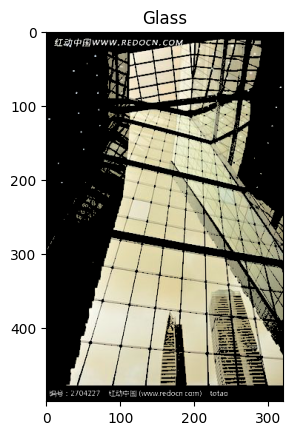

pred:  tensor([[ 0.4915, -0.3630]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\64.jpg


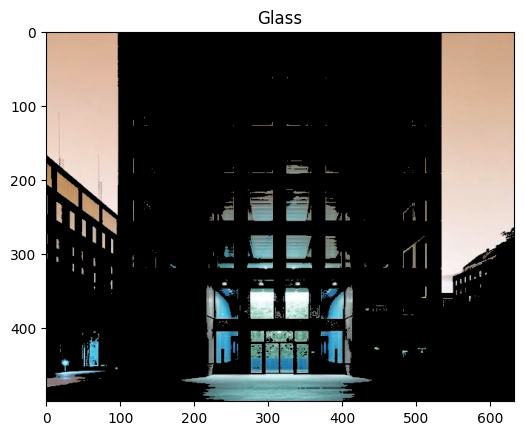

pred:  tensor([[ 0.6633, -0.4869]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\65.jpg


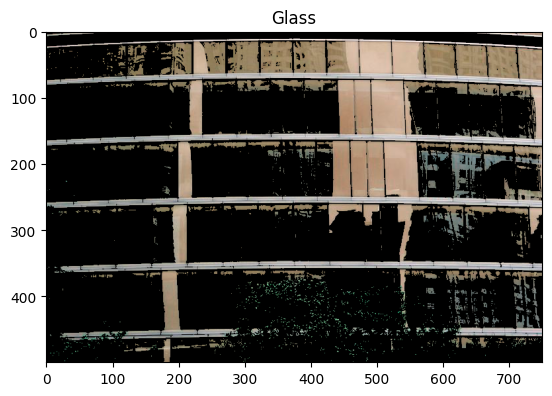

pred:  tensor([[ 1.7288, -1.7104]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\66.jpg


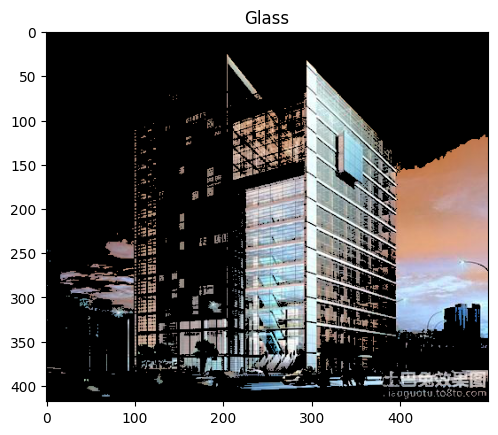

pred:  tensor([[-1.2943,  1.4195]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\67.jpg


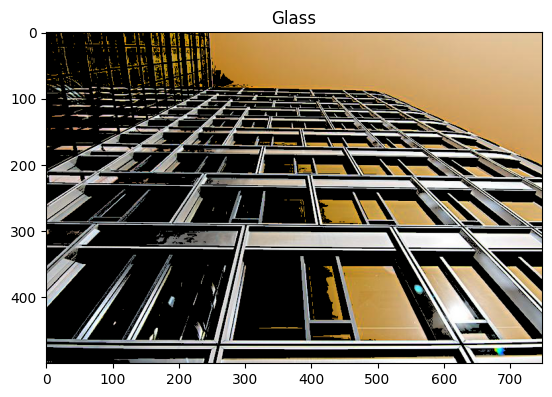

pred:  tensor([[0.0608, 0.1298]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\68.jpg


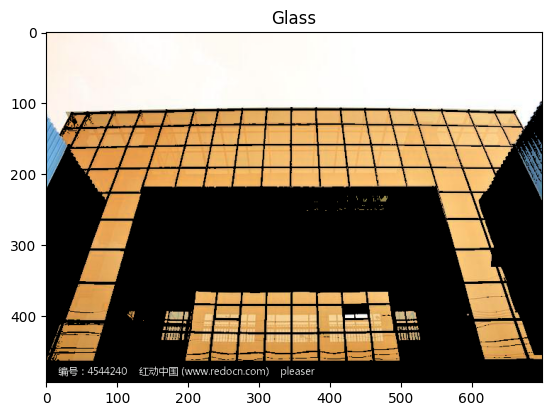

pred:  tensor([[ 3.9257, -4.9748]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\69.jpg


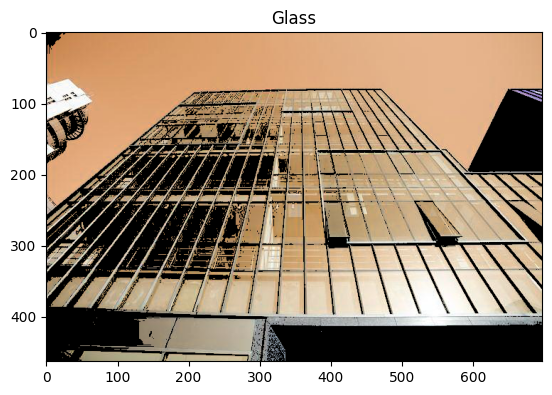

pred:  tensor([[ 0.3537, -0.1379]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\7.jpg


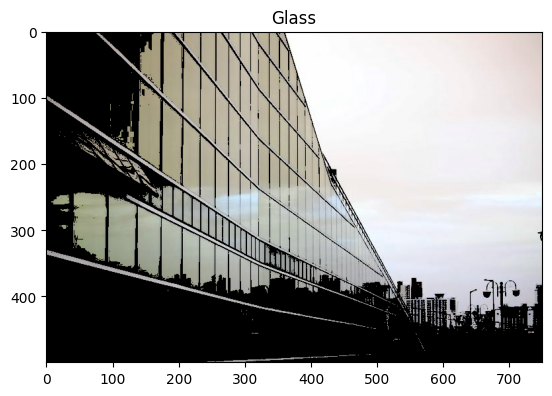

pred:  tensor([[-0.2917,  0.4847]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\70.jpg


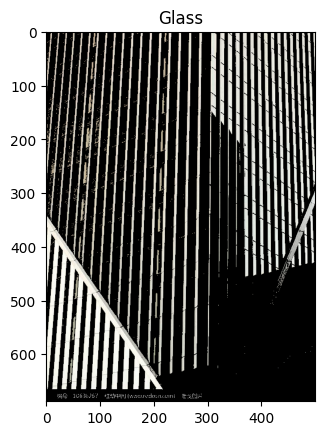

pred:  tensor([[ 2.0032, -2.0276]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\71.jpg


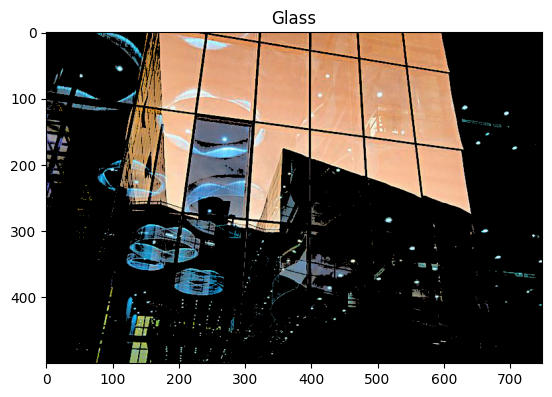

pred:  tensor([[ 0.6183, -0.6783]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\72.jpg


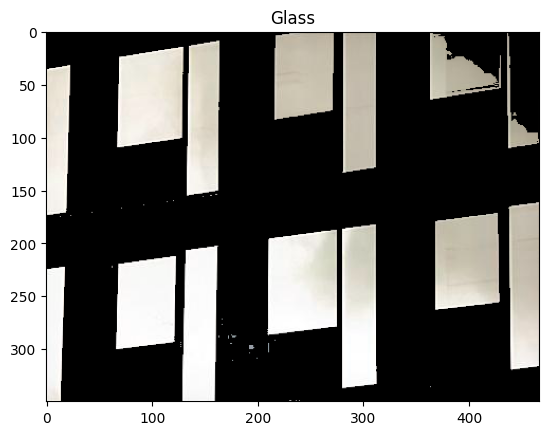

pred:  tensor([[ 1.9617, -1.8508]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\73.jpg


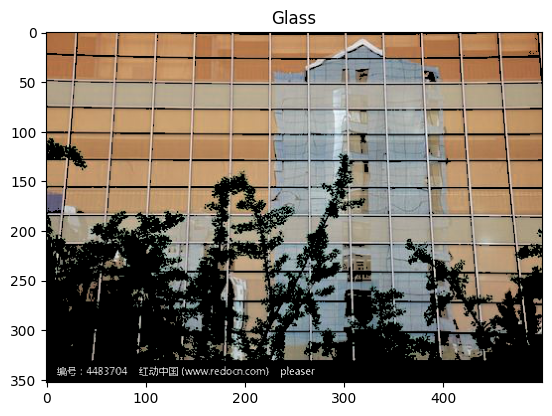

pred:  tensor([[ 2.4533, -3.4418]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\8.jpg


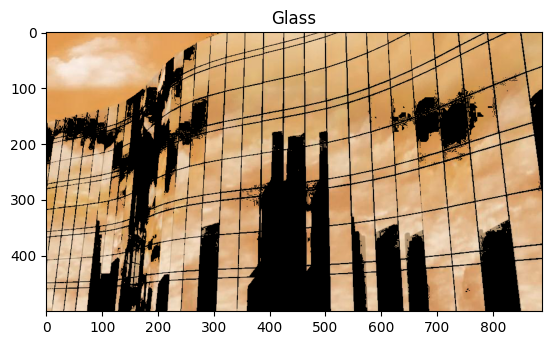

pred:  tensor([[ 2.4676, -3.0955]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\9.jpg


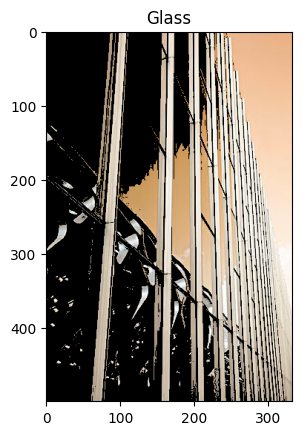

pred:  tensor([[ 0.6880, -0.5231]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\inputData\image\curtain1.jpg


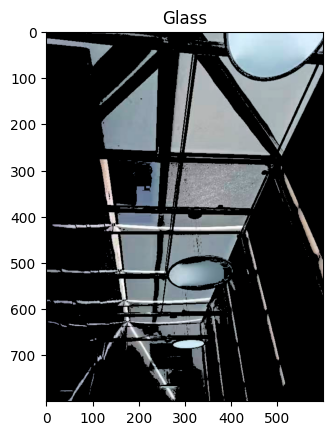

pred:  tensor([[-0.2822,  0.4478]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\inputData\image\curtain2.jpg


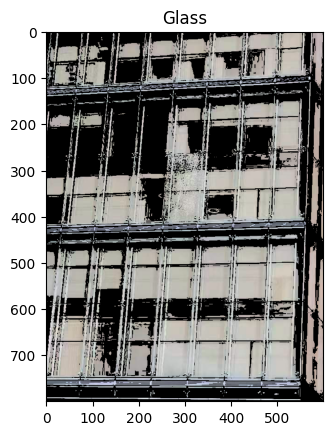

pred:  tensor([[ 2.5885, -2.9453]], device='cuda:0') 
cls:  0
完整玻璃



In [60]:
test_dir = r"D:/glassData/inputData/image/"
img_paths = glob.glob(os.path.join(test_dir, "*.jpg"))
oknumber = 0
nonumber = 0
for image_path in img_paths:
    image_path = os.path.normpath(image_path)
    print(image_path)
    if(Classify(image_path)):
        oknumber+=1
    else :
        nonumber+=1

##### 受限于两个条件：
1.照片要是局部的照片，不能拍一整栋楼的照片来分割识别（这样清晰度也不行）
2.照片清晰度不要太低，否则识别和分割的时候导致爆裂的细节消失

满足以上条件，算法效率不错，大部分照片都是可以识别正确的

In [56]:
oknumber

53

In [57]:
nonumber

21

无人机照片测试

D:\glassData\giveData\DJI_20220119094126_0009_SUPR.JPG


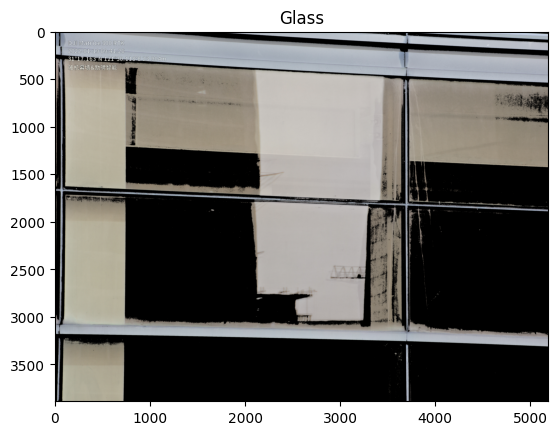

pred:  tensor([[ 1.9644, -2.0005]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094128_0010_SUPR.JPG


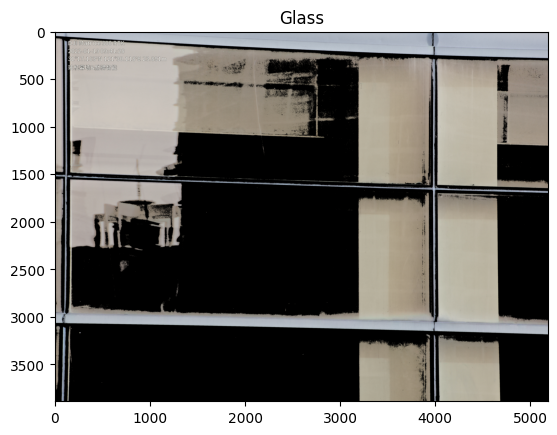

pred:  tensor([[ 1.7907, -1.8027]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094130_0011_SUPR.JPG


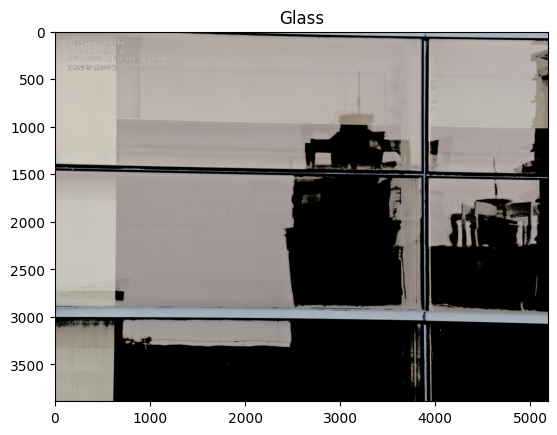

pred:  tensor([[ 0.4817, -0.3056]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094132_0012_SUPR.JPG


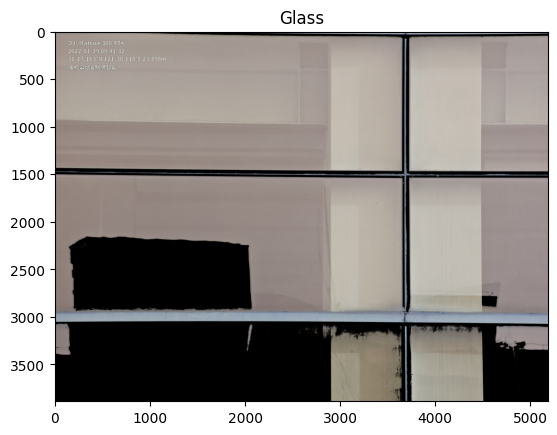

pred:  tensor([[ 1.4904, -1.6253]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094134_0013_SUPR.JPG


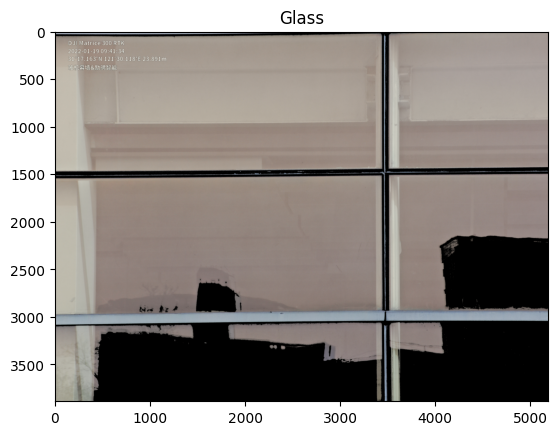

pred:  tensor([[ 0.6665, -0.5378]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094136_0014_SUPR.JPG


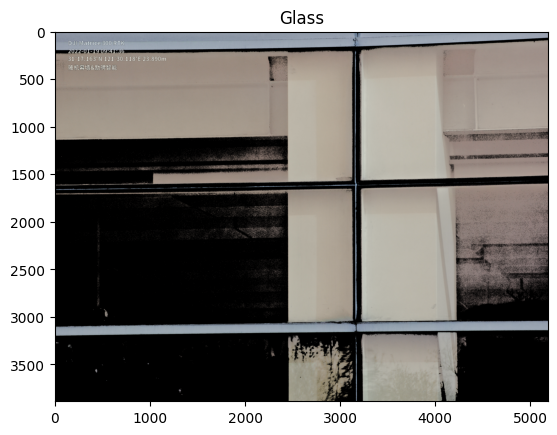

pred:  tensor([[ 2.5829, -3.3196]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094138_0015_SUPR.JPG


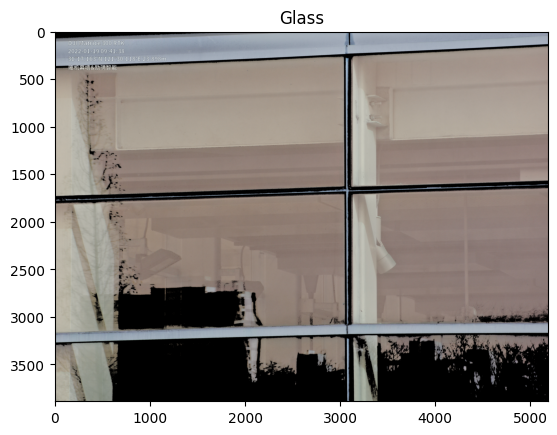

pred:  tensor([[ 1.5328, -1.3463]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094140_0016_SUPR.JPG


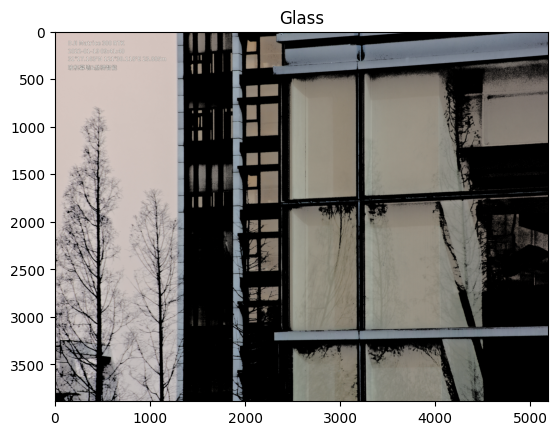

pred:  tensor([[ 2.1844, -2.5174]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094142_0017_SUPR.JPG


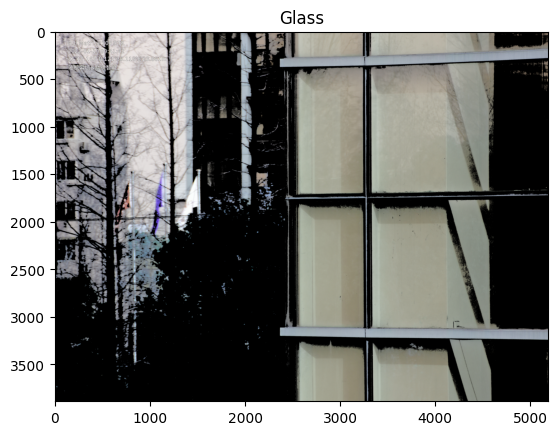

pred:  tensor([[ 1.5393, -1.4635]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094144_0018_SUPR.JPG


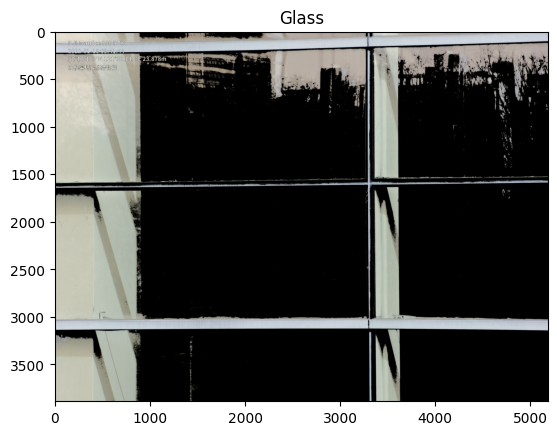

pred:  tensor([[ 1.3187, -1.1810]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094146_0019_SUPR.JPG


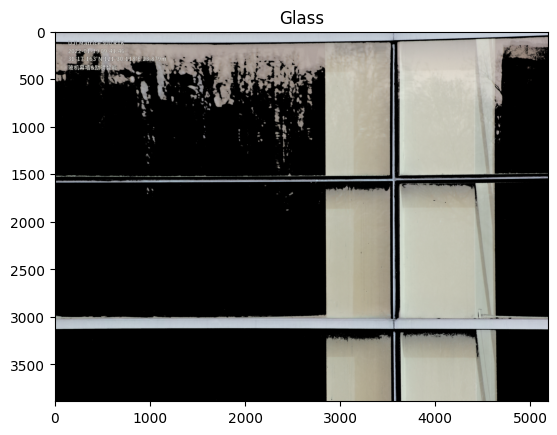

pred:  tensor([[ 2.0189, -2.5714]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094148_0020_SUPR.JPG


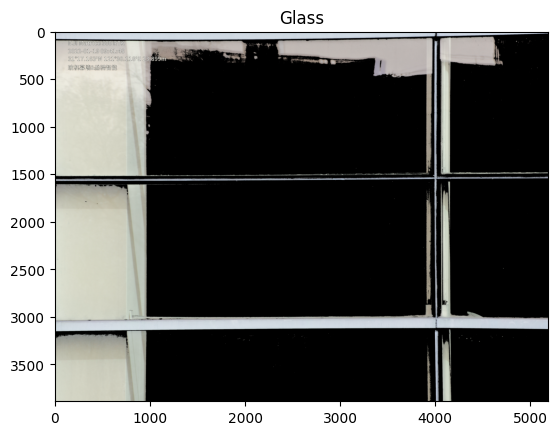

pred:  tensor([[ 0.6993, -0.5229]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094150_0021_SUPR.JPG


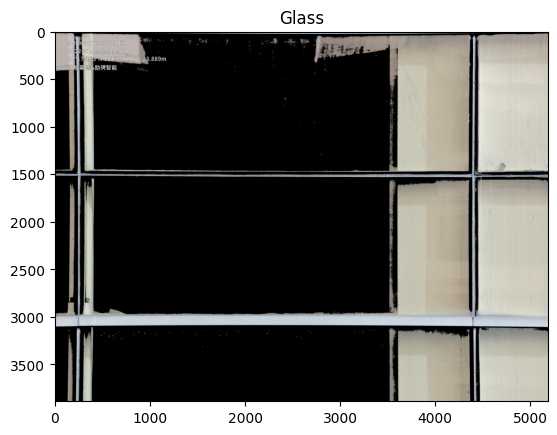

pred:  tensor([[ 1.2338, -1.5145]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094153_0022_SUPR.JPG


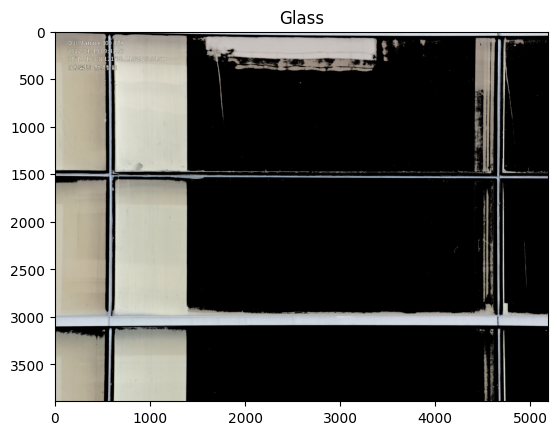

pred:  tensor([[ 1.8514, -1.9311]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094155_0023_SUPR.JPG


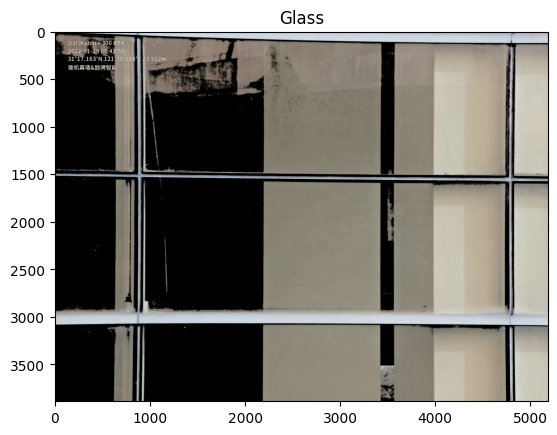

pred:  tensor([[ 4.1697, -5.6680]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094157_0024_SUPR.JPG


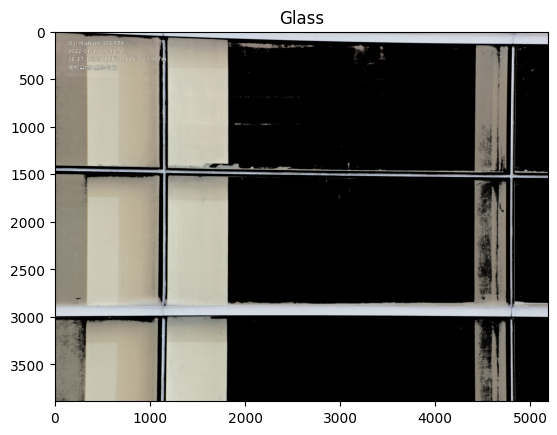

pred:  tensor([[ 1.6261, -1.6870]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094159_0025_SUPR.JPG


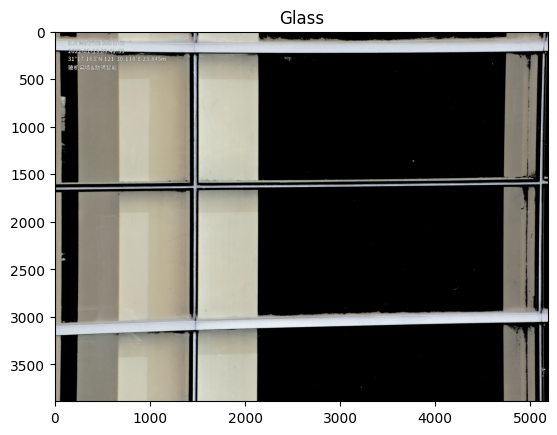

pred:  tensor([[ 3.1489, -3.7341]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094201_0026_SUPR.JPG


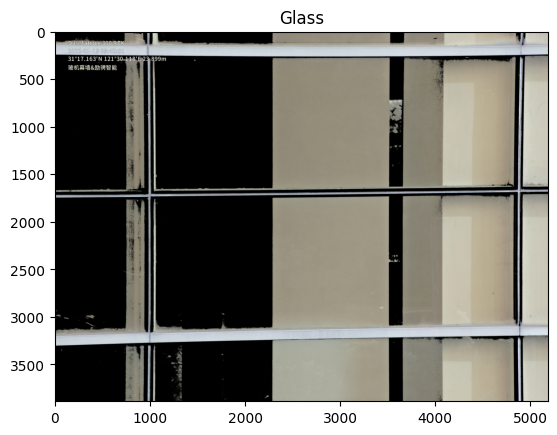

pred:  tensor([[ 4.3207, -6.0404]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094203_0027_SUPR.JPG


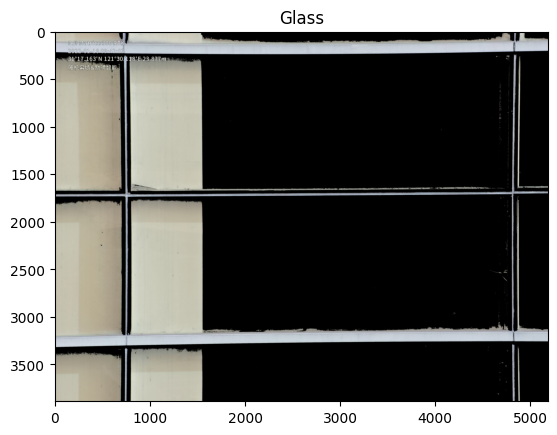

pred:  tensor([[ 2.1817, -2.4466]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094205_0028_SUPR.JPG


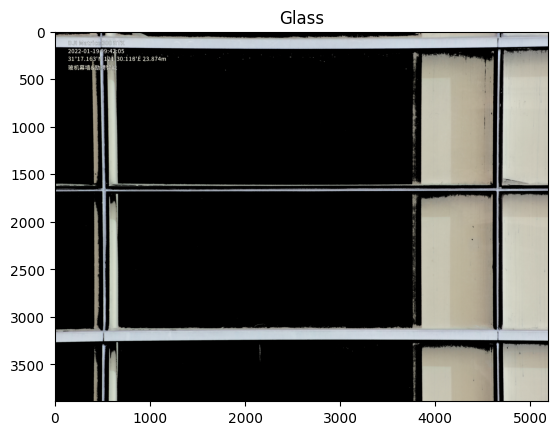

pred:  tensor([[ 1.6202, -1.7622]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094207_0029_SUPR.JPG


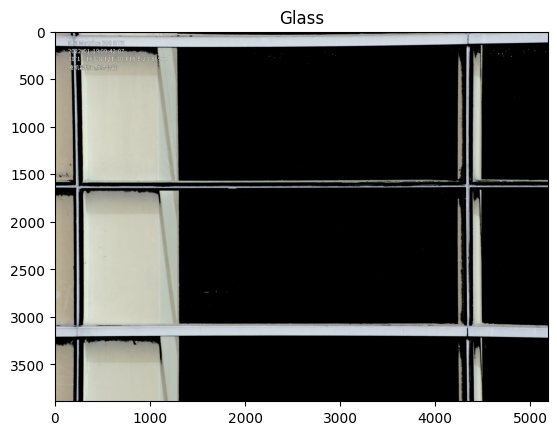

pred:  tensor([[ 1.9479, -1.7936]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094209_0030_SUPR.JPG


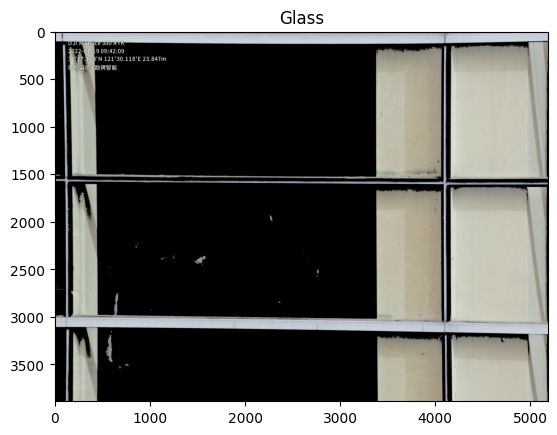

pred:  tensor([[ 1.6023, -1.9024]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094211_0031_SUPR.JPG


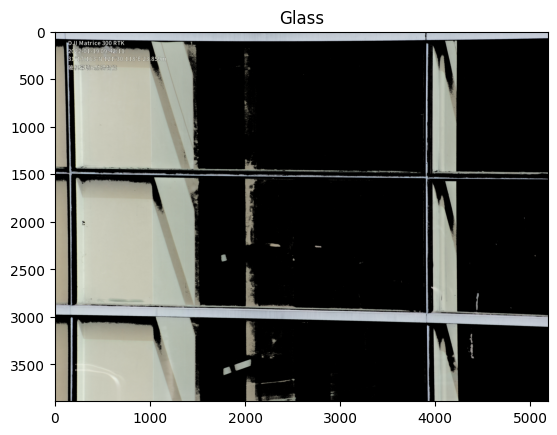

pred:  tensor([[ 0.4844, -0.3064]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094214_0032_SUPR.JPG


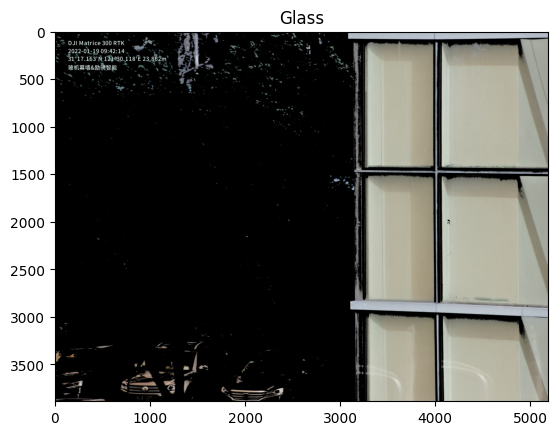

pred:  tensor([[0.1084, 0.0305]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094216_0033_SUPR.JPG


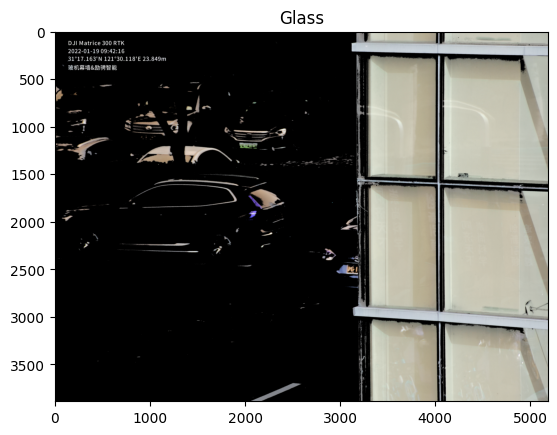

pred:  tensor([[-0.7045,  0.7272]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\giveData\DJI_20220119094218_0034_SUPR.JPG


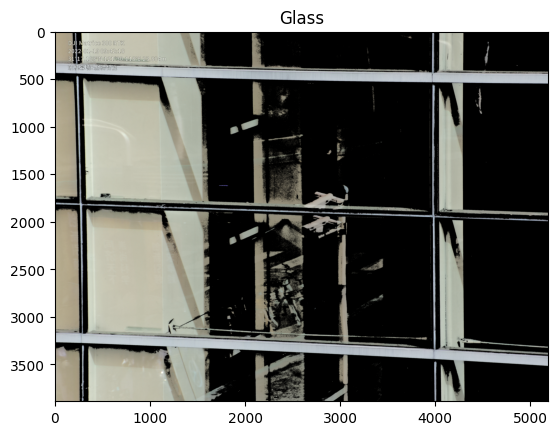

pred:  tensor([[ 1.5695, -1.4186]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094220_0035_SUPR.JPG


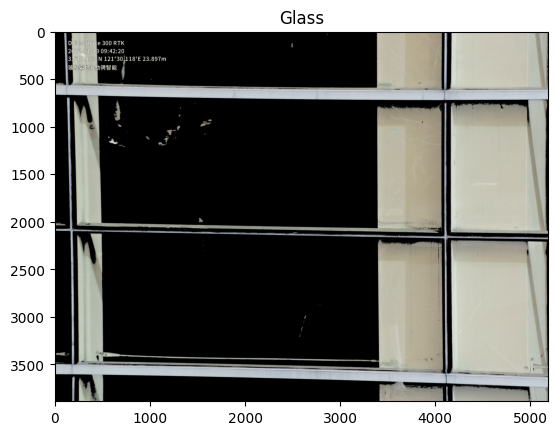

pred:  tensor([[ 2.4129, -3.0593]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094222_0036_SUPR.JPG


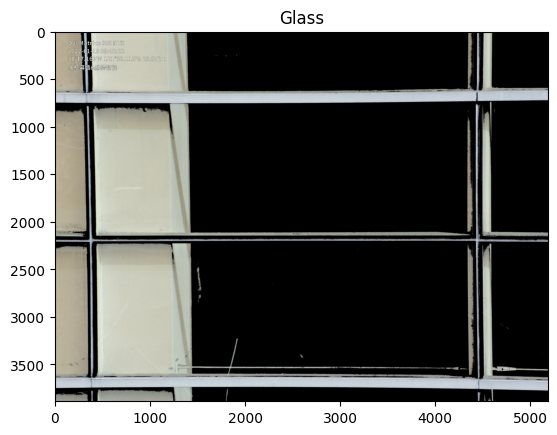

pred:  tensor([[ 1.9494, -1.8589]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094224_0037_SUPR.JPG


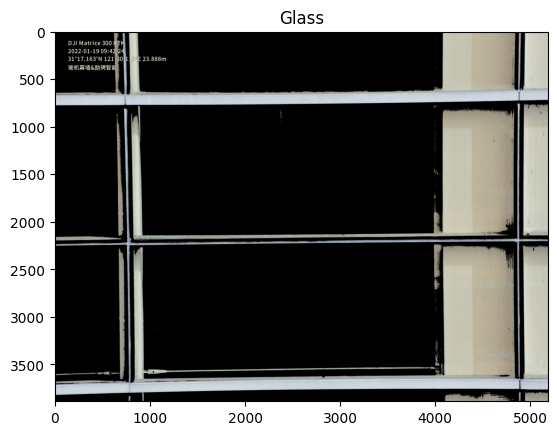

pred:  tensor([[ 1.5977, -1.6297]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094226_0038_SUPR.JPG


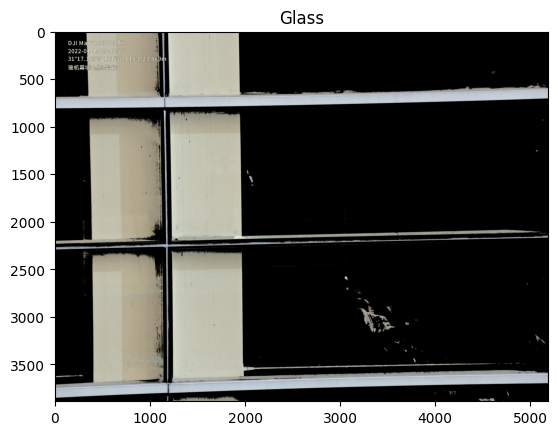

pred:  tensor([[ 1.6741, -1.6540]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094228_0039_SUPR.JPG


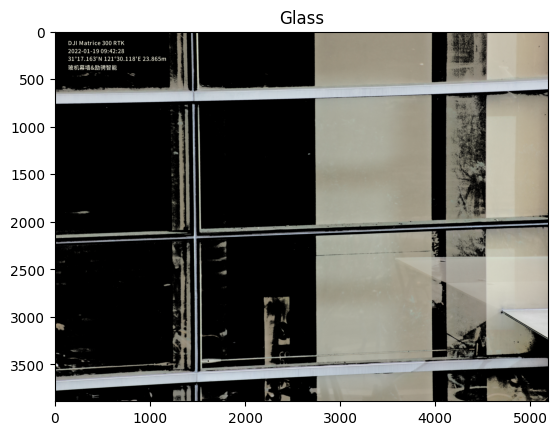

pred:  tensor([[ 2.1307, -2.2354]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094230_0040_SUPR.JPG


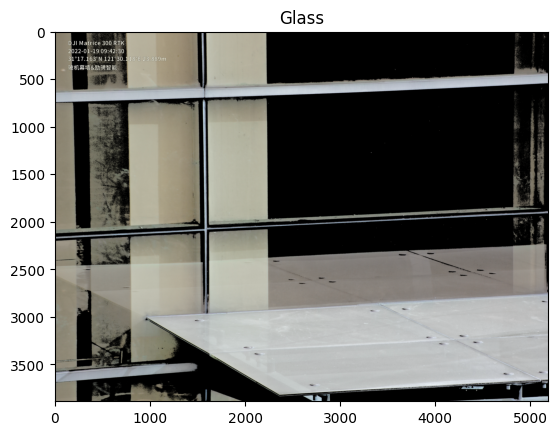

pred:  tensor([[ 2.8584, -3.4673]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094232_0041_SUPR.JPG


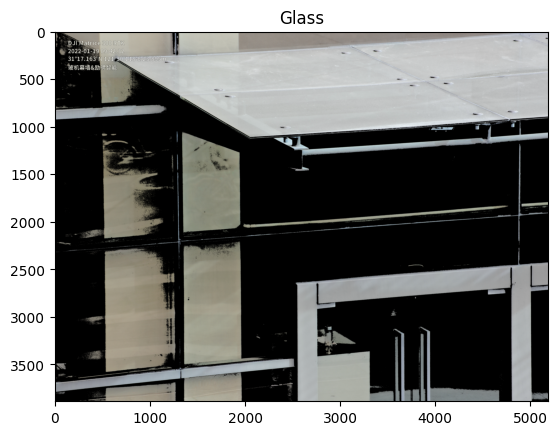

pred:  tensor([[ 2.4657, -2.8350]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094234_0042_SUPR.JPG


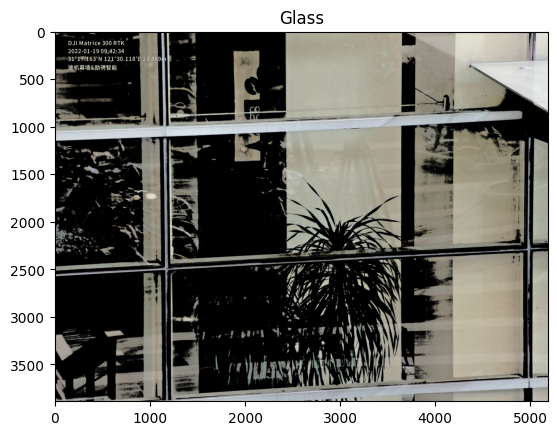

pred:  tensor([[ 1.5107, -1.4134]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094236_0043_SUPR.JPG


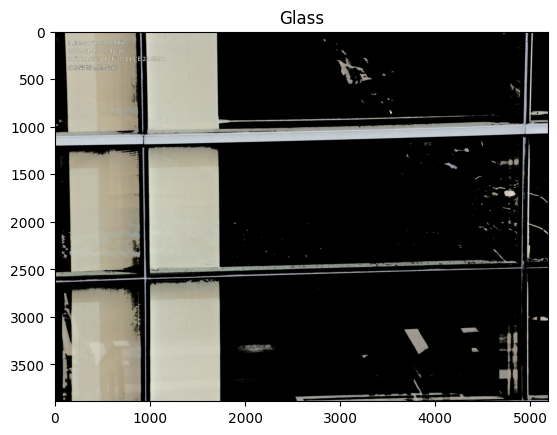

pred:  tensor([[ 1.6227, -1.6092]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094238_0044_SUPR.JPG


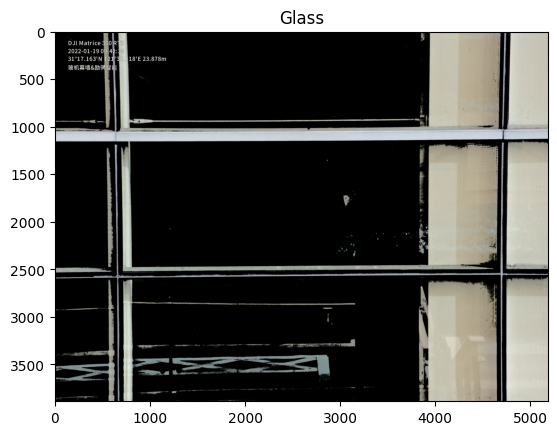

pred:  tensor([[ 1.5476, -1.6141]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094240_0045_SUPR.JPG


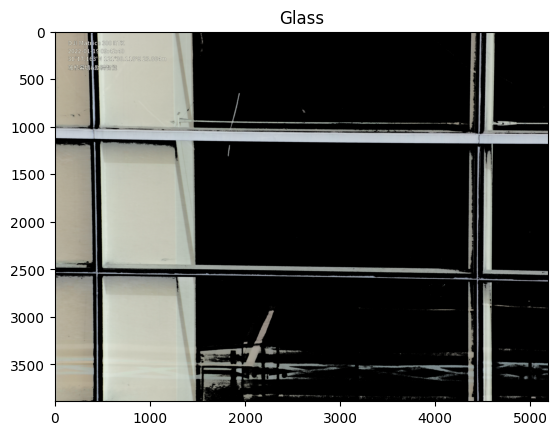

pred:  tensor([[ 1.4537, -1.2969]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094242_0046_SUPR.JPG


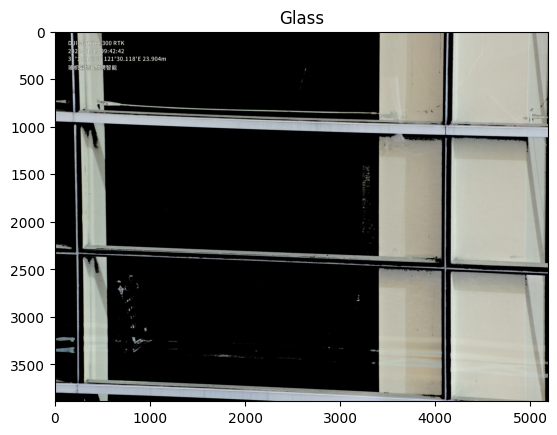

pred:  tensor([[ 2.1944, -2.5312]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094244_0047_SUPR.JPG


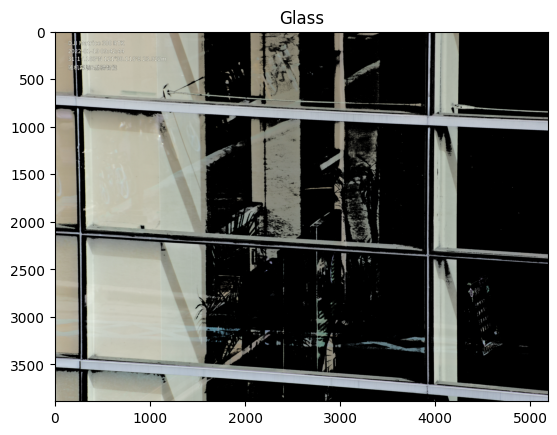

pred:  tensor([[ 2.0907, -1.9553]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094246_0048_SUPR.JPG


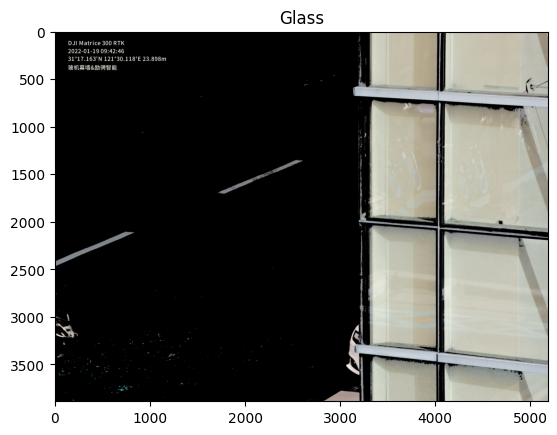

pred:  tensor([[ 1.2866, -1.4316]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094248_0049_SUPR.JPG


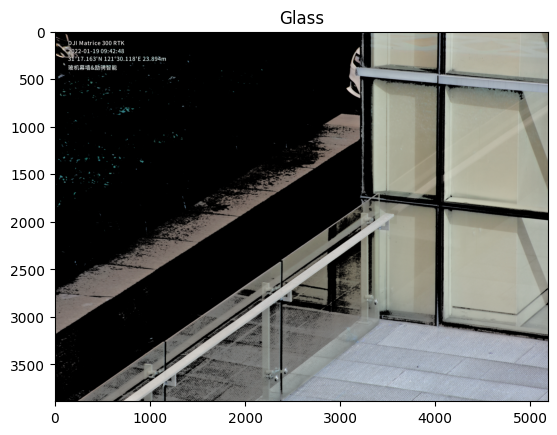

pred:  tensor([[ 1.8422, -2.0226]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094250_0050_SUPR.JPG


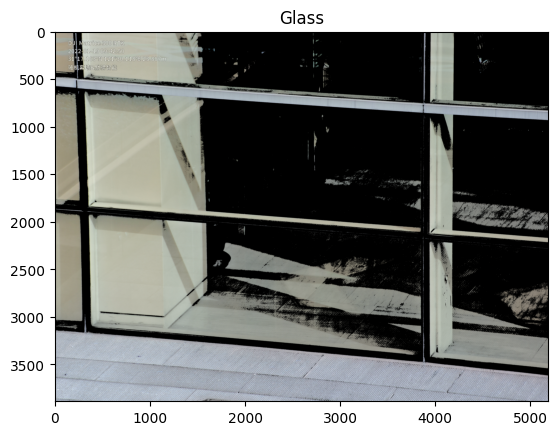

pred:  tensor([[ 1.2817, -1.0985]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094252_0051_SUPR.JPG


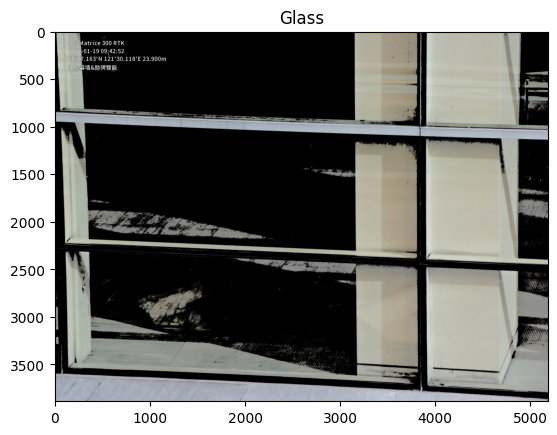

pred:  tensor([[ 1.5307, -1.8544]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094254_0052_SUPR.JPG


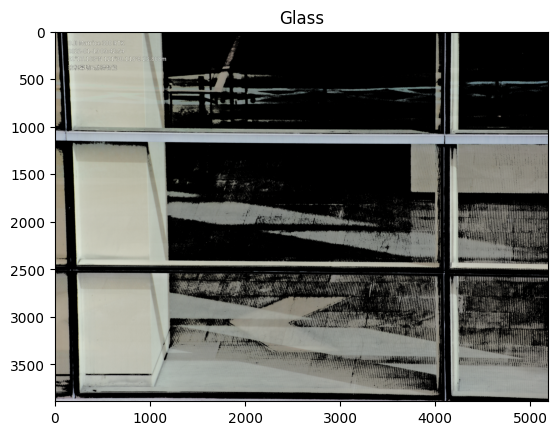

pred:  tensor([[ 1.7493, -1.5901]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094256_0053_SUPR.JPG


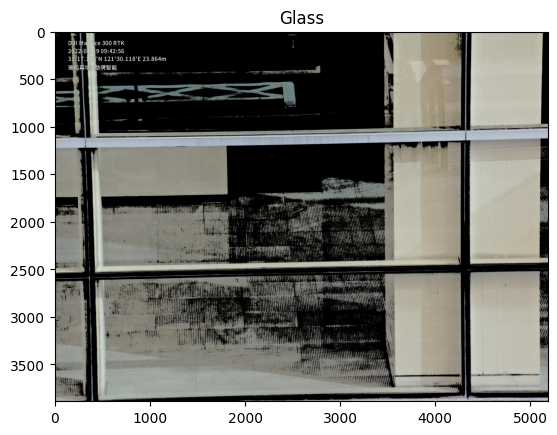

pred:  tensor([[ 2.1099, -2.2460]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094258_0054_SUPR.JPG


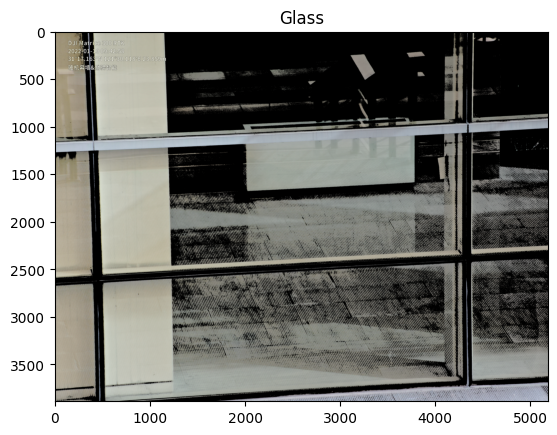

pred:  tensor([[ 2.0243, -1.9423]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094300_0055_SUPR.JPG


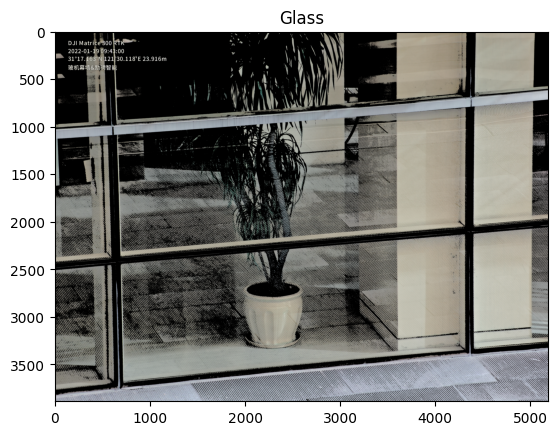

pred:  tensor([[ 1.7991, -1.9619]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094303_0056_SUPR.JPG


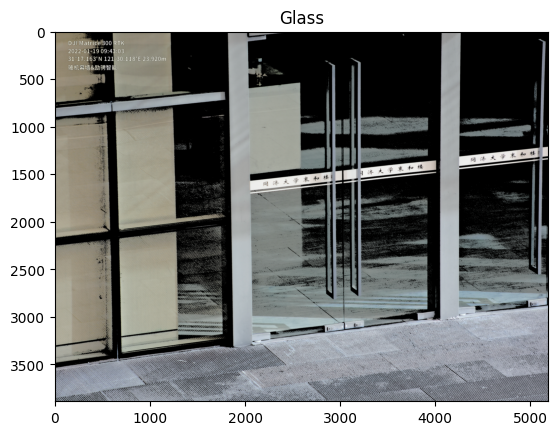

pred:  tensor([[ 2.8064, -3.4033]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094408_0000_W.JPG


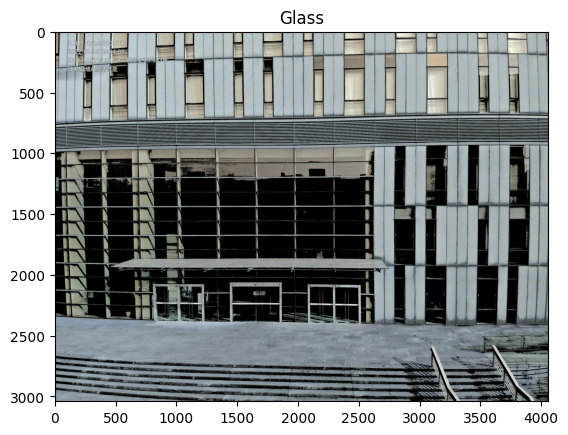

pred:  tensor([[ 3.8571, -5.2028]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094410_0001_SUPR.JPG


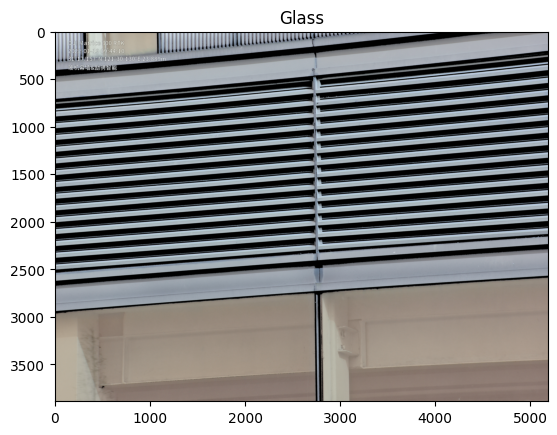

pred:  tensor([[ 0.7394, -0.5822]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094412_0002_SUPR.JPG


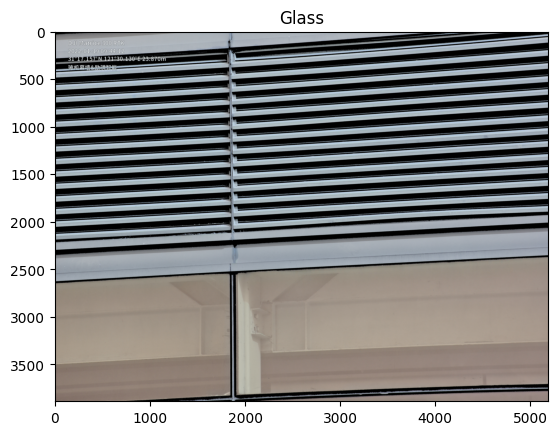

pred:  tensor([[ 1.0150, -0.8460]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094414_0003_SUPR.JPG


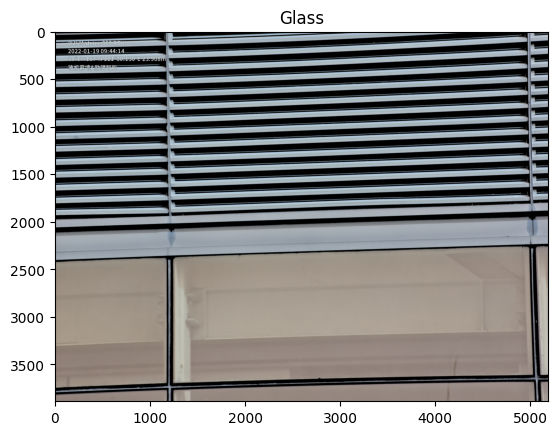

pred:  tensor([[ 0.4140, -0.2638]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094416_0004_SUPR.JPG


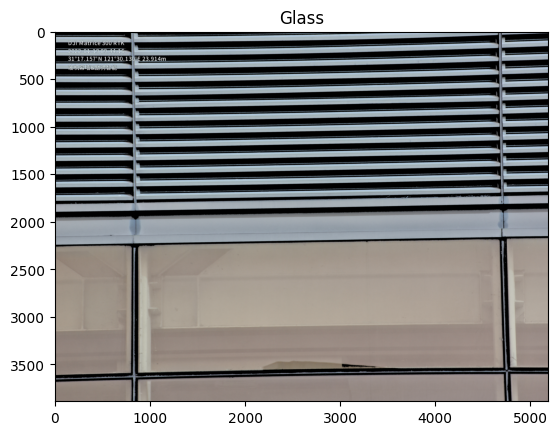

pred:  tensor([[ 1.4463, -1.2549]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094419_0005_SUPR.JPG


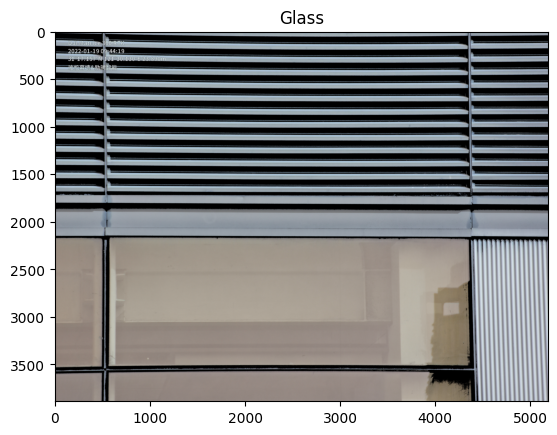

pred:  tensor([[ 1.7005, -1.6261]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094420_0006_SUPR.JPG


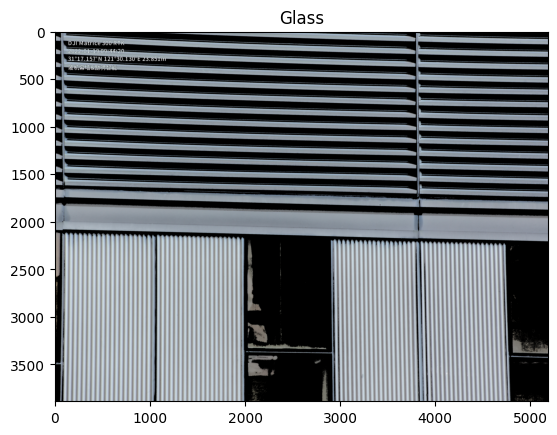

pred:  tensor([[ 1.4098, -1.2947]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094423_0007_SUPR.JPG


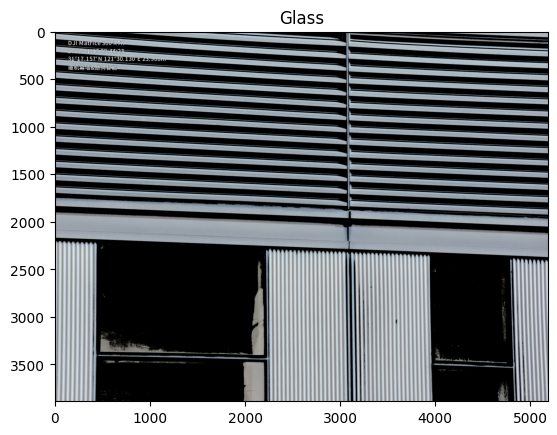

pred:  tensor([[ 0.9576, -0.8108]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094425_0008_SUPR.JPG


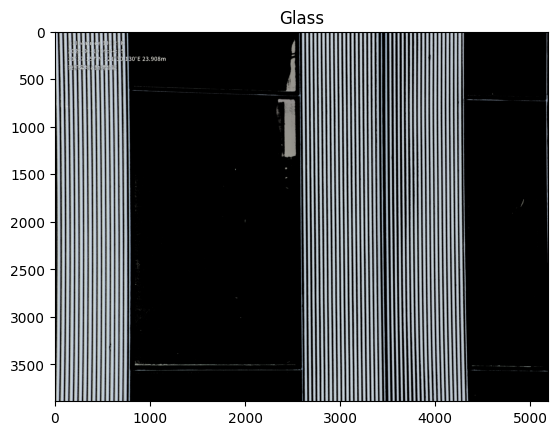

pred:  tensor([[ 2.0123, -2.1625]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094427_0009_SUPR.JPG


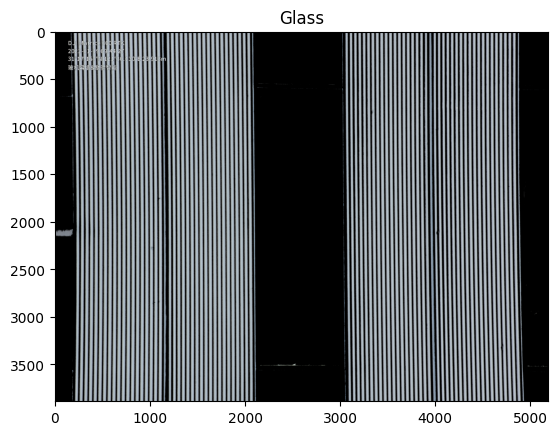

pred:  tensor([[ 2.8249, -3.2489]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094429_0010_SUPR.JPG


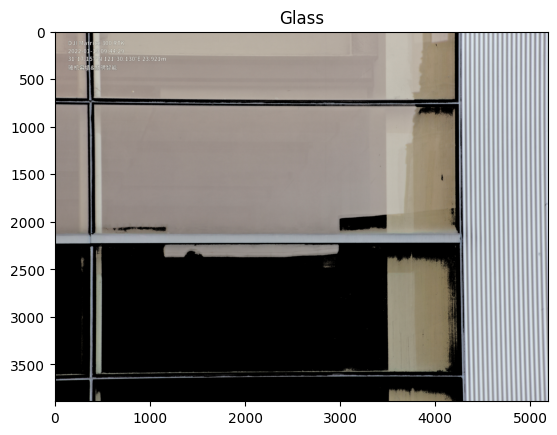

pred:  tensor([[ 2.9443, -3.4932]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094431_0011_SUPR.JPG


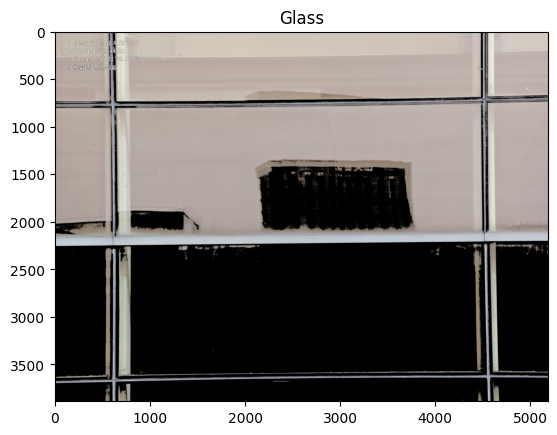

pred:  tensor([[ 2.7179, -2.9552]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094433_0012_SUPR.JPG


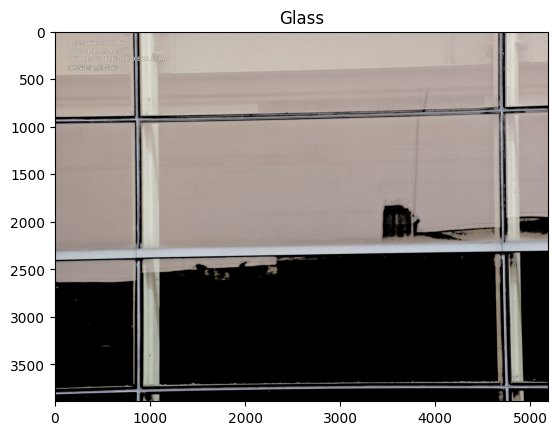

pred:  tensor([[ 1.9745, -1.7611]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094435_0013_SUPR.JPG


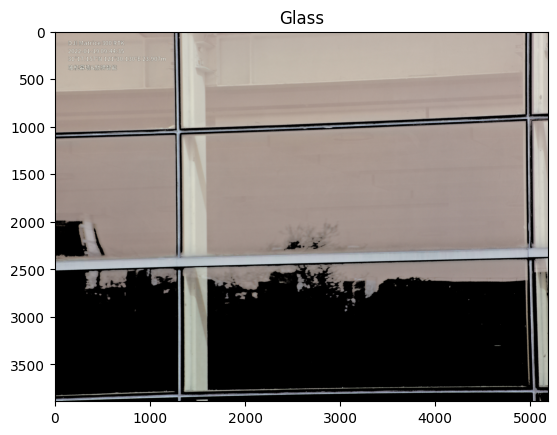

pred:  tensor([[ 2.1910, -2.3753]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094437_0014_SUPR.JPG


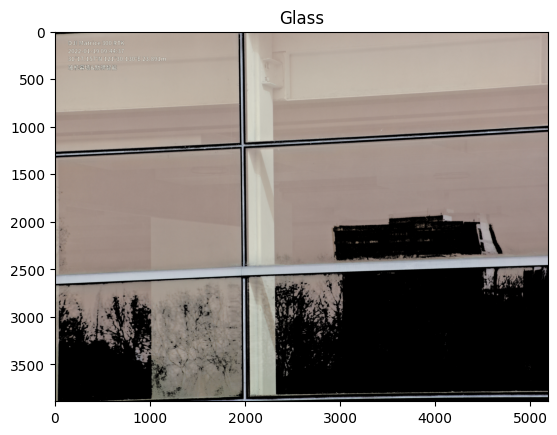

pred:  tensor([[ 1.8758, -1.6913]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094439_0015_SUPR.JPG


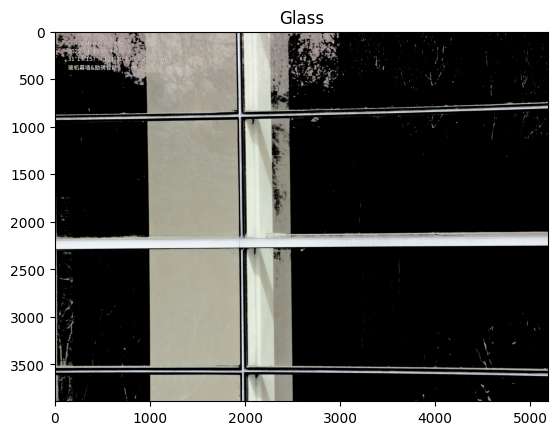

pred:  tensor([[ 2.2486, -2.5608]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094441_0016_SUPR.JPG


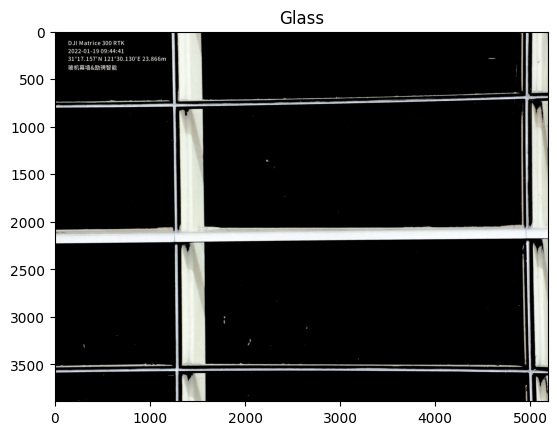

pred:  tensor([[ 1.3930, -1.2379]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094443_0017_SUPR.JPG


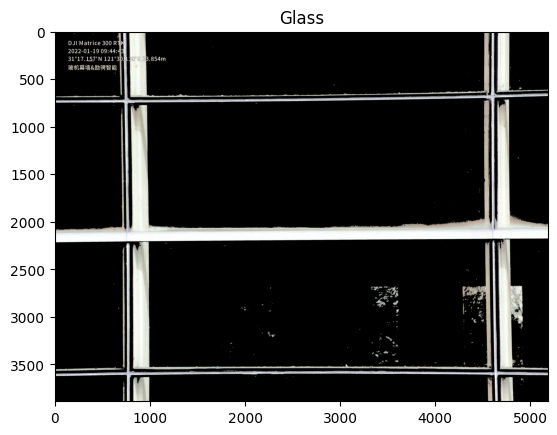

pred:  tensor([[ 1.2649, -1.0994]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094446_0018_SUPR.JPG


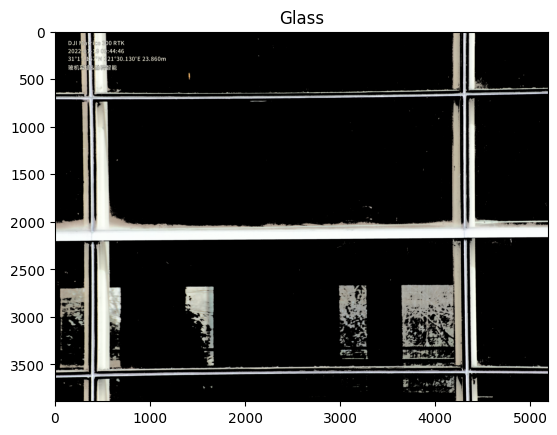

pred:  tensor([[0.1356, 0.0231]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094448_0019_SUPR.JPG


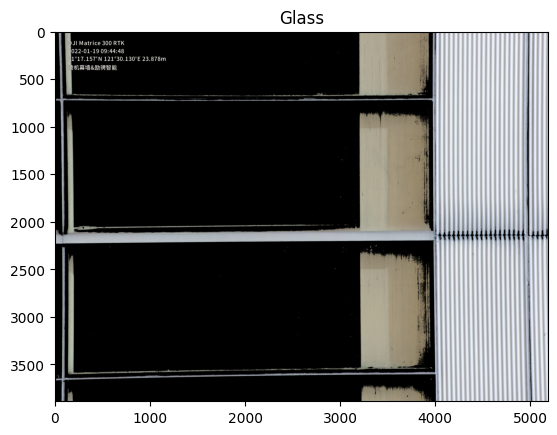

pred:  tensor([[ 2.1869, -2.6597]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094450_0020_SUPR.JPG


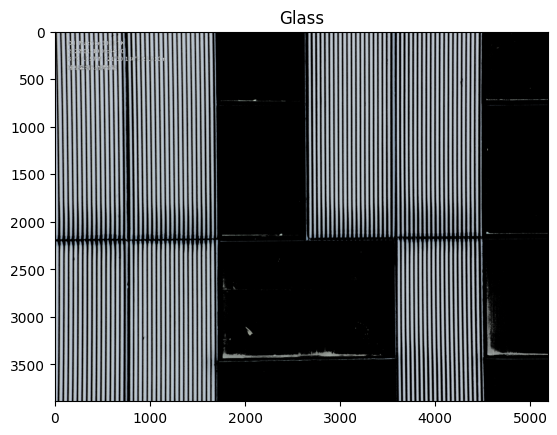

pred:  tensor([[ 2.7094, -3.1815]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094452_0021_SUPR.JPG


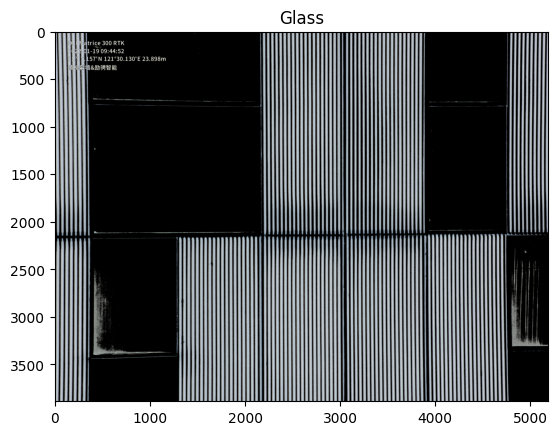

pred:  tensor([[ 1.8305, -1.9016]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094454_0022_SUPR.JPG


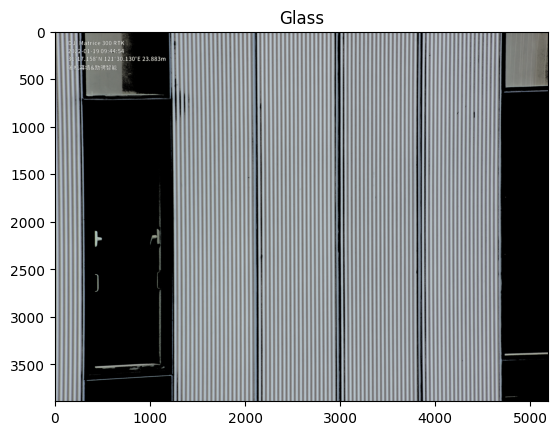

pred:  tensor([[ 2.3477, -2.7762]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094456_0023_SUPR.JPG


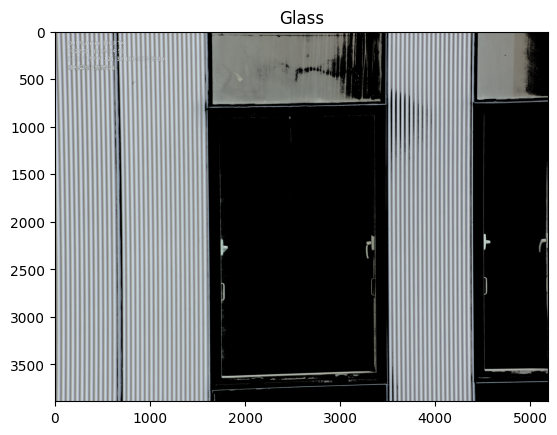

pred:  tensor([[ 2.8085, -3.2393]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094459_0024_SUPR.JPG


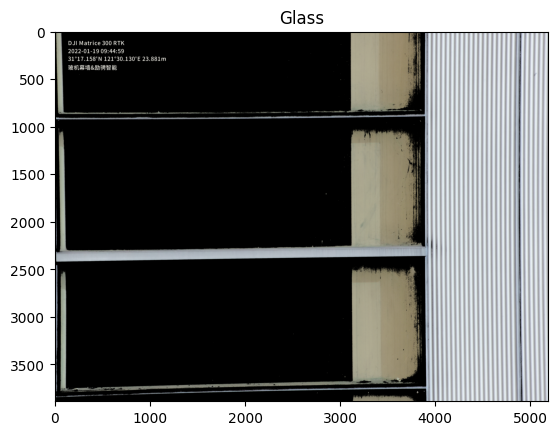

pred:  tensor([[ 1.6085, -2.0480]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094501_0025_SUPR.JPG


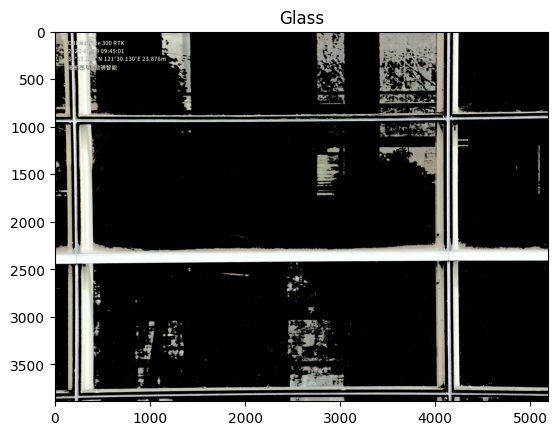

pred:  tensor([[ 0.3097, -0.1509]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094503_0026_SUPR.JPG


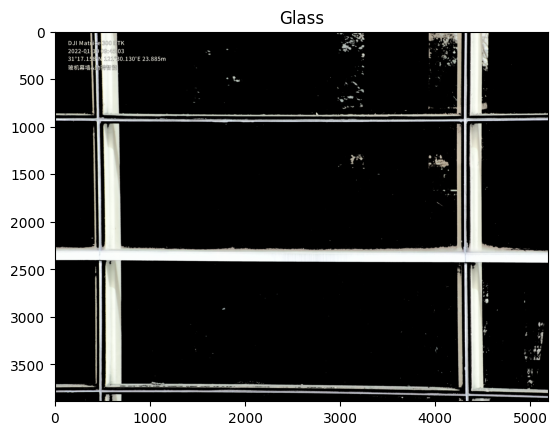

pred:  tensor([[-0.7615,  0.9200]], device='cuda:0') 
cls:  1
碎玻璃

D:\glassData\giveData\DJI_20220119094505_0027_SUPR.JPG


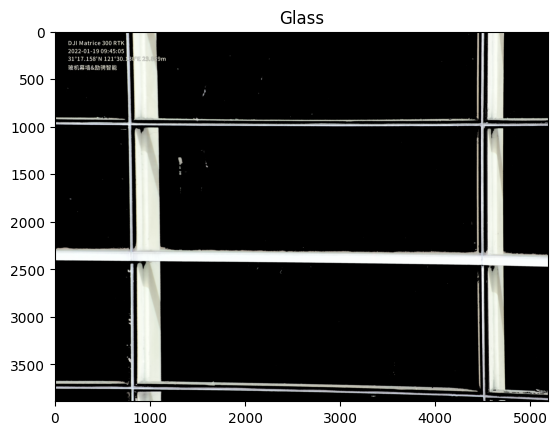

pred:  tensor([[ 0.9457, -0.7540]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094507_0028_SUPR.JPG


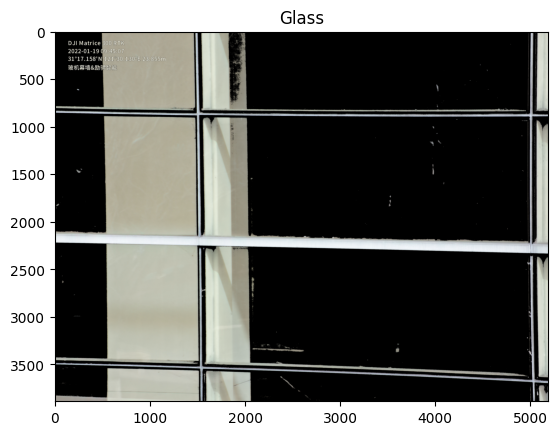

pred:  tensor([[ 1.9053, -2.0616]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094509_0029_SUPR.JPG


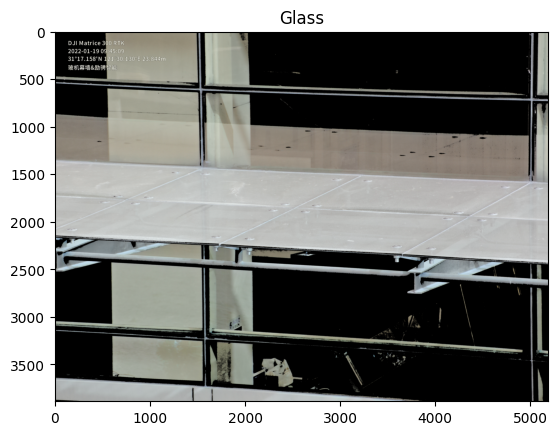

pred:  tensor([[ 1.3674, -1.2114]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094511_0030_SUPR.JPG


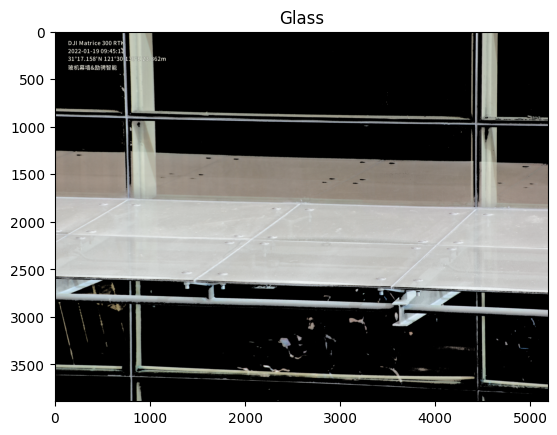

pred:  tensor([[ 1.4300, -1.2844]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094513_0031_SUPR.JPG


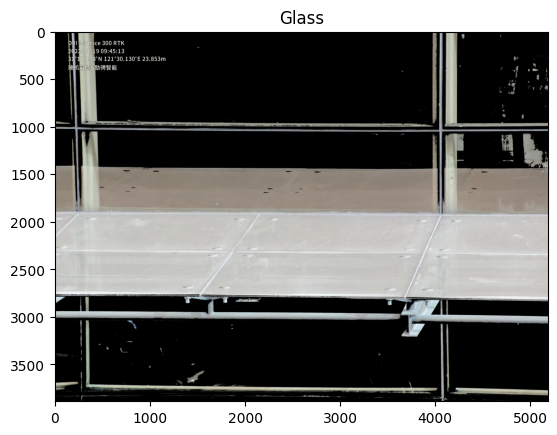

pred:  tensor([[ 1.0438, -0.8806]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094515_0032_SUPR.JPG


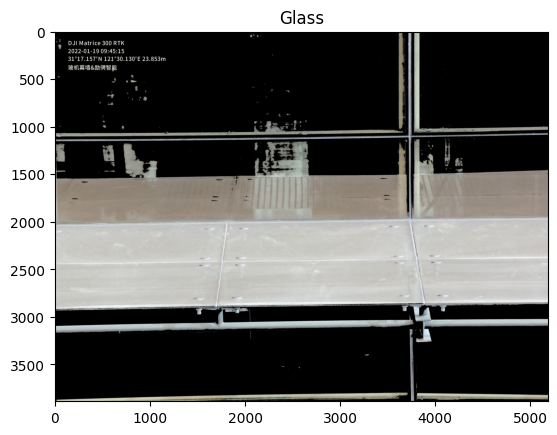

pred:  tensor([[ 1.0885, -0.9398]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094517_0033_SUPR.JPG


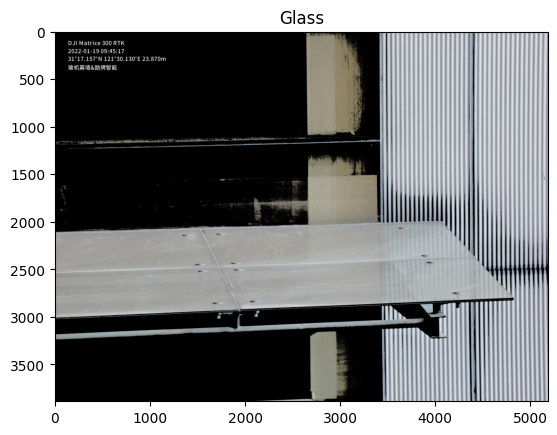

pred:  tensor([[ 1.1830, -1.2984]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094519_0034_SUPR.JPG


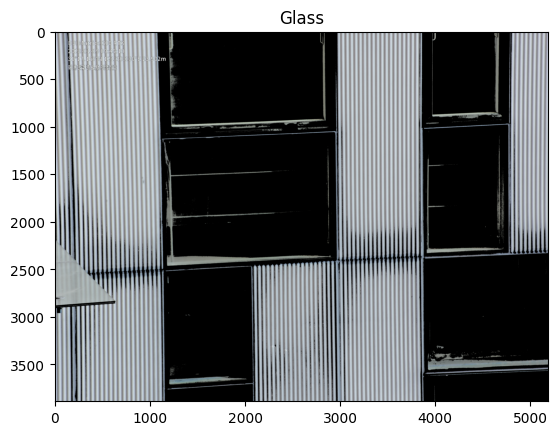

pred:  tensor([[ 2.6686, -3.2881]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094521_0035_SUPR.JPG


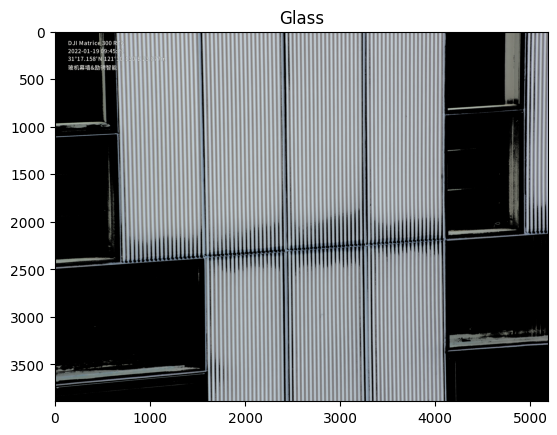

pred:  tensor([[ 2.3634, -2.5858]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094523_0036_SUPR.JPG


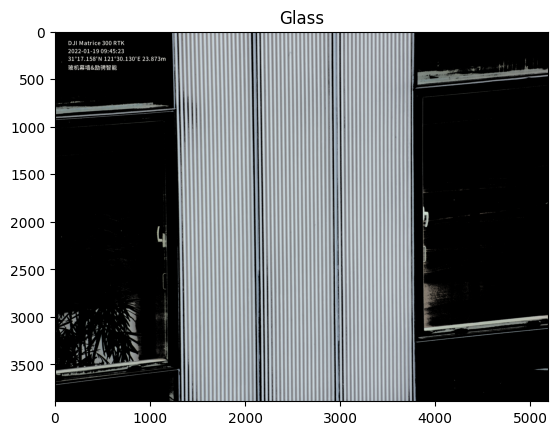

pred:  tensor([[ 2.4349, -2.9688]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094525_0037_SUPR.JPG


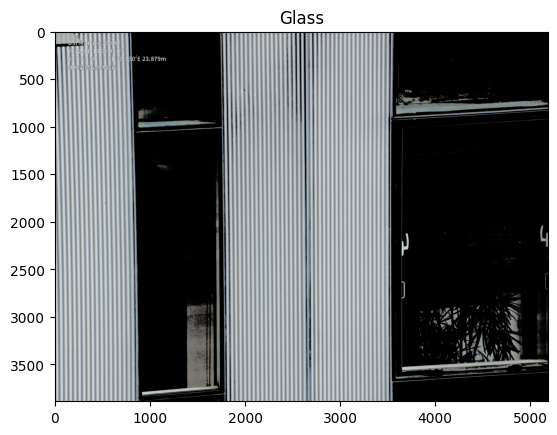

pred:  tensor([[ 1.8435, -1.9800]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094528_0038_SUPR.JPG


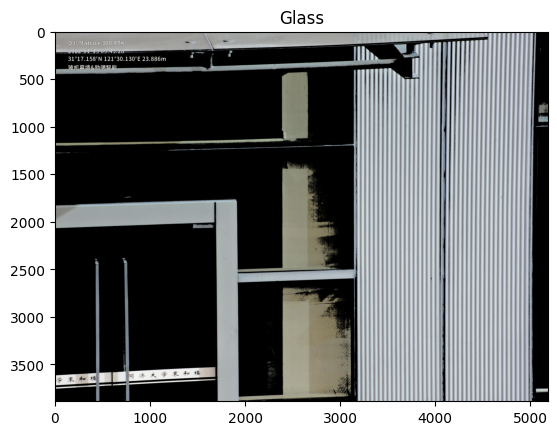

pred:  tensor([[ 2.0771, -2.3753]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094530_0039_SUPR.JPG


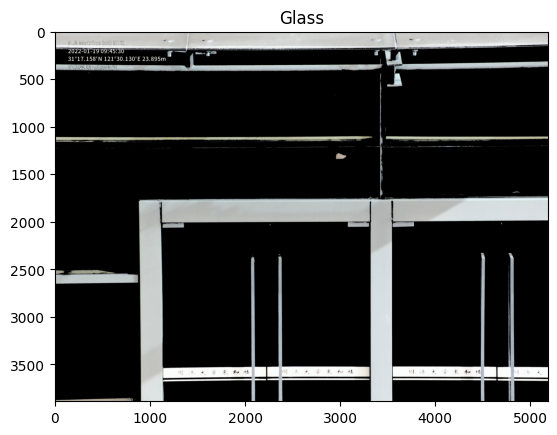

pred:  tensor([[ 1.4836, -1.3533]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094532_0040_SUPR.JPG


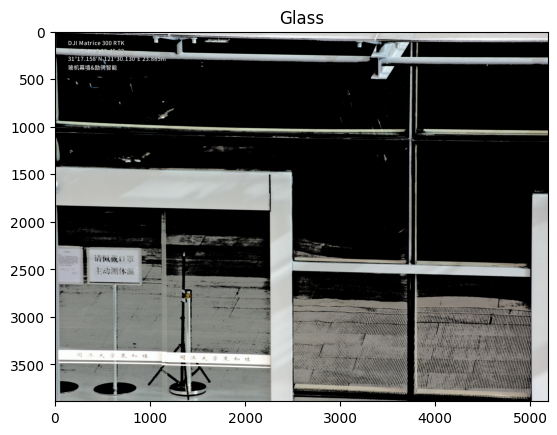

pred:  tensor([[ 1.5001, -1.6192]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094534_0041_SUPR.JPG


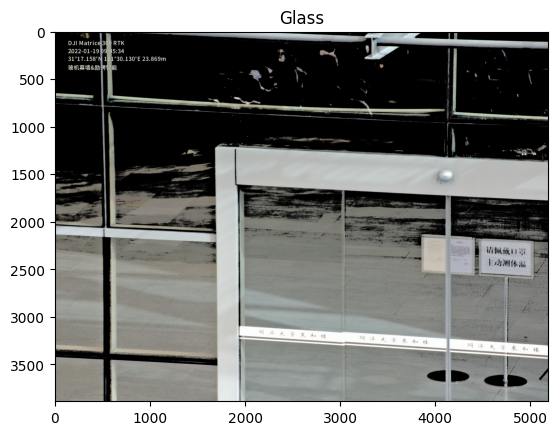

pred:  tensor([[ 1.8976, -2.1466]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094536_0042_SUPR.JPG


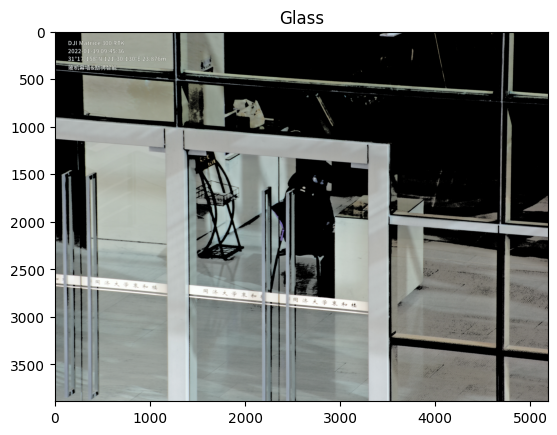

pred:  tensor([[ 2.0012, -2.1511]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094538_0043_SUPR.JPG


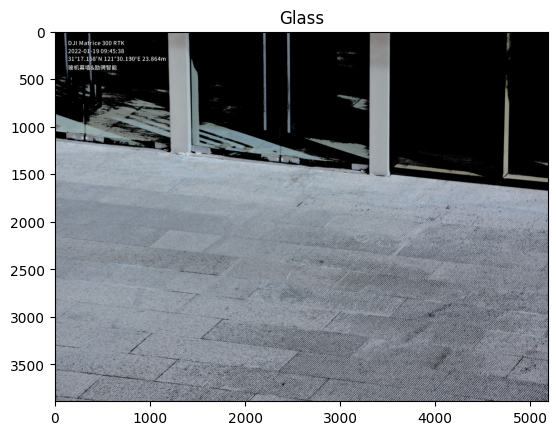

pred:  tensor([[ 1.2477, -1.1293]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094540_0044_SUPR.JPG


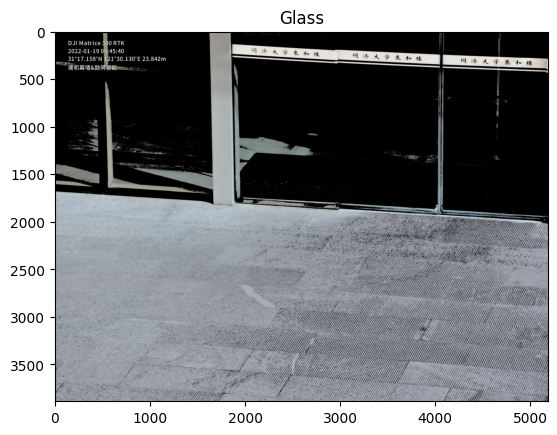

pred:  tensor([[ 1.1325, -0.9780]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094542_0045_SUPR.JPG


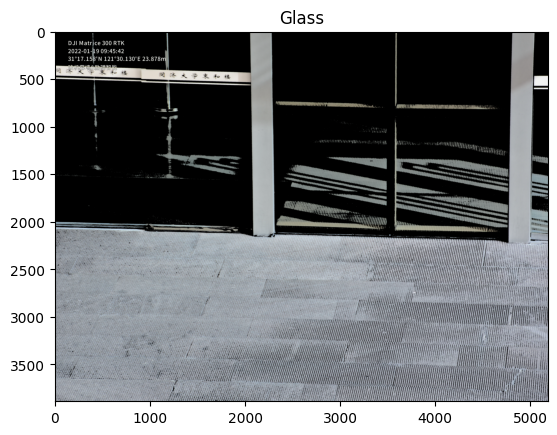

pred:  tensor([[ 2.1405, -2.2933]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094544_0046_SUPR.JPG


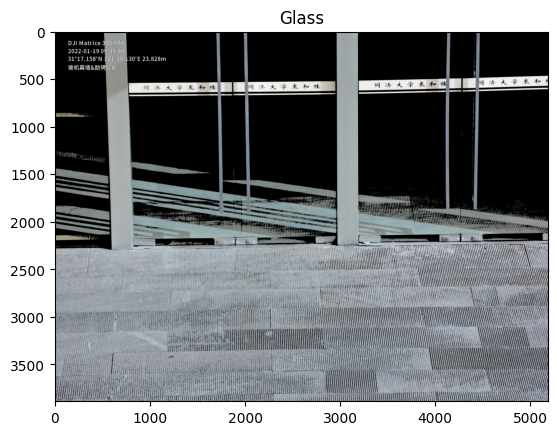

pred:  tensor([[ 2.3147, -2.4193]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094546_0047_SUPR.JPG


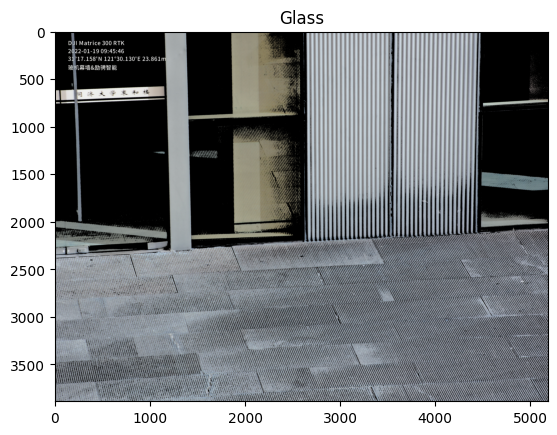

pred:  tensor([[ 2.7854, -3.5809]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094548_0048_SUPR.JPG


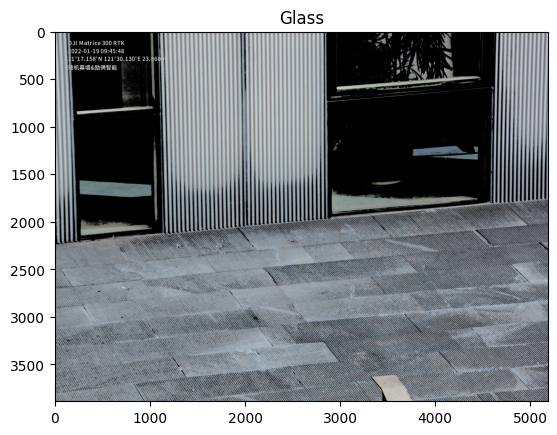

pred:  tensor([[ 1.3940, -1.3492]], device='cuda:0') 
cls:  0
完整玻璃

D:\glassData\giveData\DJI_20220119094550_0049_SUPR.JPG


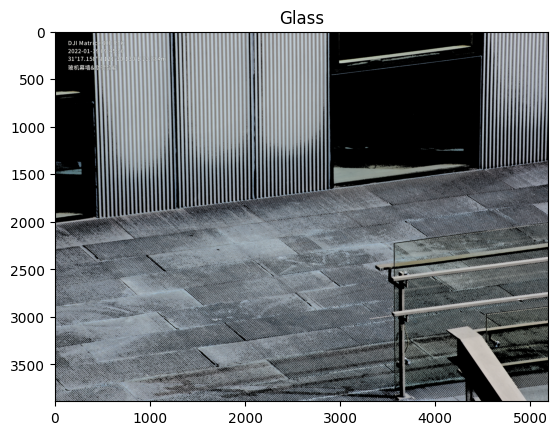

pred:  tensor([[ 0.7233, -0.5905]], device='cuda:0') 
cls:  0
完整玻璃



In [61]:
test_dir = r"D:/glassData/giveData/"
img_paths = glob.glob(os.path.join(test_dir, "*.jpg"))
oknumber = 0
nonumber = 0
for image_path in img_paths:
    image_path = os.path.normpath(image_path)
    print(image_path)
    if(Classify(image_path)):
        oknumber+=1
    else :
        nonumber+=1

In [66]:
oknumber

96

In [65]:
nonumber

2

In [67]:
1.0 * (oknumber)/(oknumber+nonumber) * 100

97.95918367346938